In [1]:
from IPython.display import display, HTML, Image
display(HTML("<style>.container { width:95% !important; }</style>"))

%load_ext autoreload
%autoreload 2

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import os
import numpy as np
import pandas as pd
import scanpy as sc

import sys
sys.path.append("../../lib")
from deg_utils import DEGonAnnData
from pathways import genesDicts

from scanpy.tools._score_genes import score_genes

from cheatmap import cplot, prepForCplot
from pathways import genesDicts
from vplot import wrapVplotRatio, wrapVplotScore, wrapVplotGene
from stpalette import palette_WM4007_rna, palette_WM4237_rna

from plots import plotSpatialAll


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    Loading pathways from : C:\Projects\A_ST\github-pipelines\PDX-melanoma-integrated-analysis\pathways/


C:\Projects\A_ST\github-pipelines\PDX-melanoma-integrated-analysis\modules\WM4237\../../lib\cheatmap.py:23: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def sMED(v1, v2):


In [2]:
model = 'WM4237'
palette_rna = palette_WM4007_rna if model=='WM4007' else palette_WM4237_rna

In [3]:
dataPath = '../../data/'
preprocessedStDataPath = 'd:/from HPCC 11 28 2022/results_NF1-nod-t2t-k35/%s/' % model

ids = sorted(np.loadtxt(dataPath + 'ids_%s_ST.txt' % model, dtype=str))
print(ids)

['WM4237_T0_S1_ST', 'WM4237_T0_S2_ST', 'WM4237_T1_S1_ST', 'WM4237_T1_S2_ST', 'WM4237_T2_S1_ST', 'WM4237_T2_S2_ST', 'WM4237_T3_S1_ST', 'WM4237_T3_S2_ST', 'WM4237_T4_S1_ST', 'WM4237_T4_S2_ST', 'WM4237_TC_S1_ST', 'WM4237_TC_S2_ST', 'WM4237_TE_S1_ST', 'WM4237_TE_S2_ST', 'WM4237_TE_S3_ST', 'WM4237_TE_S4_ST']


In [4]:
ids = pd.Series(ids)
cond1 = ids.str.contains('E_S')
cond2 = ids.str.contains('0_S')
cond3 = ids.str.contains('C_S')
#ids = ids[cond1].values.tolist() + ids[cond2].values.tolist() + ids[cond3].values.tolist() + ids[~cond1 & ~cond2 & ~cond3].values.tolist()
ids = ids[cond2].values.tolist() + ids[cond3].values.tolist() + ids[~cond1 & ~cond2 & ~cond3].values.tolist()
print(ids)

['WM4237_T0_S1_ST', 'WM4237_T0_S2_ST', 'WM4237_TC_S1_ST', 'WM4237_TC_S2_ST', 'WM4237_T1_S1_ST', 'WM4237_T1_S2_ST', 'WM4237_T2_S1_ST', 'WM4237_T2_S2_ST', 'WM4237_T3_S1_ST', 'WM4237_T3_S2_ST', 'WM4237_T4_S1_ST', 'WM4237_T4_S2_ST']


In [5]:
ad_all = sc.read(dataPath + 'ad_all_human_clustered_st_%s.h5ad' % model)
ad_all.shape

(18406, 18720)

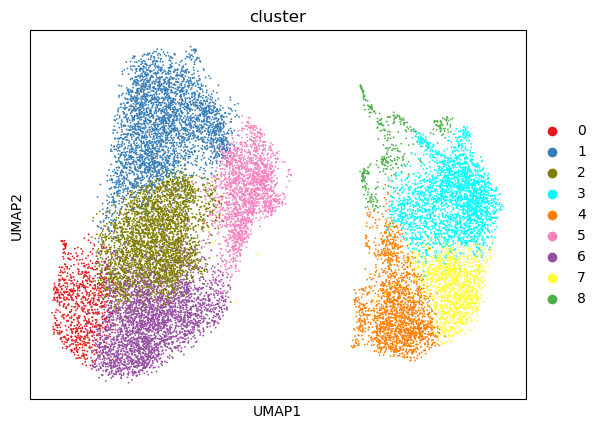

In [6]:
sc.pl.umap(ad_all, color='cluster', palette=palette_rna)

In [7]:
# se = np.exp(ad_all[ad_all.obs[ad_all.obs['T'].isin(['T0', 'TE', 'TC'])].index].to_df()).sub(1.).sum(axis=0)
# se.to_csv('WM4237-1.untreated-bulk.norm-linear.csv')

In [6]:
ads = {id: ad_all[ad_all.obs['sample']==id, :] for id in ids}

images = {id: sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id).uns['spatial'] for id in ids}

for sample in ids[:]:
    ads[sample] = ad_all[ad_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample]

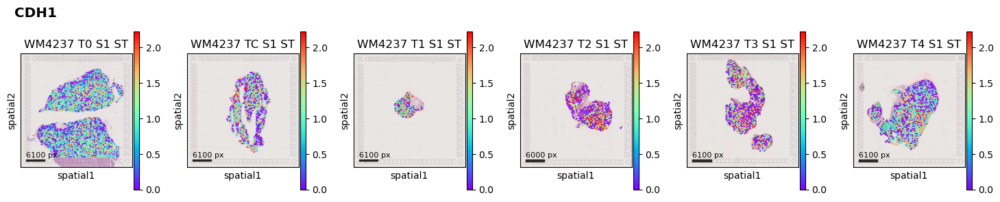

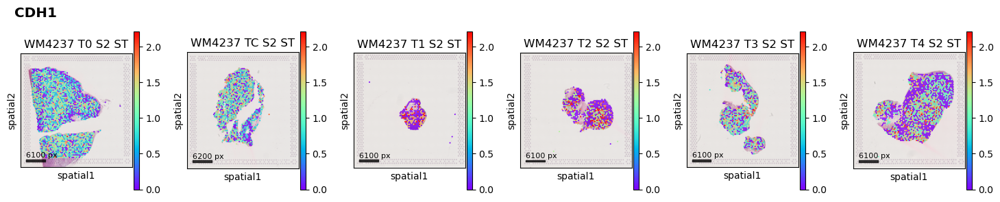

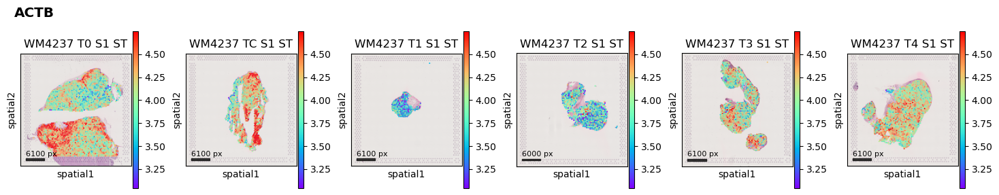

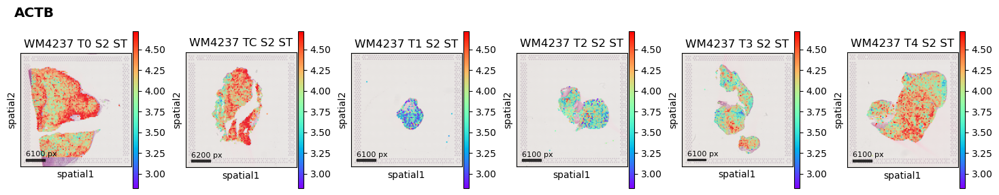

In [11]:
plotSpatialAll(ads, ids=[id for id in ids if ('_S1_' in id)], identity='CDH1', palette=palette_WM4237_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)
plotSpatialAll(ads, ids=[id for id in ids if ('_S2_' in id)], identity='CDH1', palette=palette_WM4237_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)
plotSpatialAll(ads, ids=[id for id in ids if ('_S1_' in id)], identity='ACTB', palette=palette_WM4237_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)
plotSpatialAll(ads, ids=[id for id in ids if ('_S2_' in id)], identity='ACTB', palette=palette_WM4237_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)

In [12]:
def add_genes_ratio(ads, gene1, gene2):
    for id in ads.keys():
        a = ads[id][:, gene1].to_df().values[:, 0]
        b = ads[id][:, gene2].to_df().values[:, 0]
        #a[np.where(a==0)] = 1
        #b[np.where(b==0)] = 1
        ads[id].obs[f'{gene1}_{gene2}'] = a - b
    return

add_genes_ratio(ads, 'ACTB', 'CDH1')

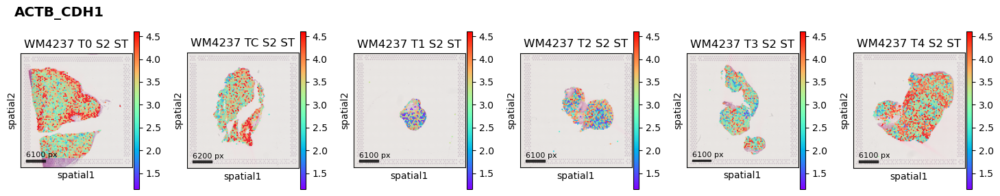

In [13]:
plotSpatialAll(ads, ids=[id for id in ids if ('_S2_' in id)], identity='ACTB_CDH1', palette=palette_WM4007_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)

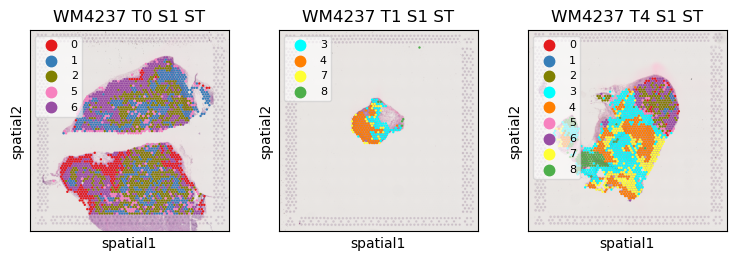

In [9]:
plotSpatialAll(ads, ids=[id for id in ids if (('_S1_' in id) and ('_T0_' in id)) or (('_S1_' in id) and ('_T1_' in id)) or (('_S1_' in id) and ('_T4_' in id))],
               identity='cluster', palette=palette_WM4237_rna, f=0.75, nx=3, panelSize=4, y=1.0, wspace=0.25, maintainScale=True, title='')

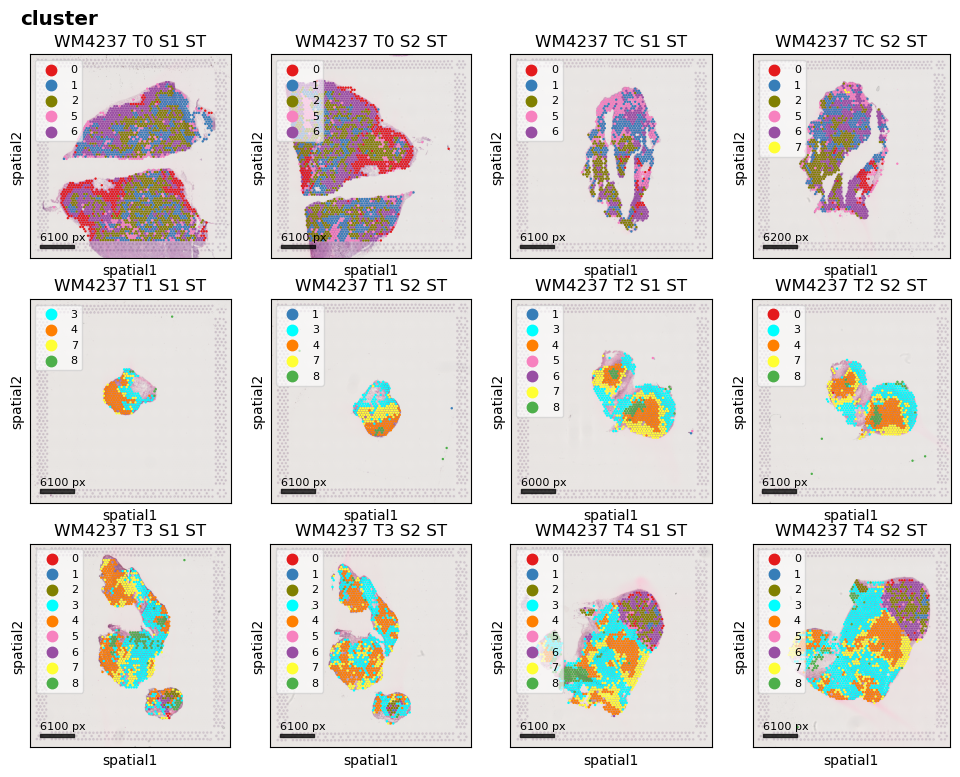

In [12]:
plotSpatialAll(ads, ids=[id for id in ids if '' in id], identity='cluster', palette=palette_WM4237_rna, f=0.75, nx=4, panelSize=4)

In [114]:
from scipy.stats import ttest_ind, ttest_rel, mannwhitneyu, hypergeom

In [36]:
from scipy.spatial.distance import pdist, squareform

In [156]:
def pv(a, b, c, v=False):
    p = mannwhitneyu(ses.xs(a, level=1)[b], ses.xs(a, level=1)[c]).pvalue
    if v:
        print(f'Nearest to {a}: in {b} and {c} - p-value is {p}')
    return [f'{a}_{b}_{c}', p]

In [173]:
gses = []

for id in ids[:]:
    print(id)
    try:
        df = pd.DataFrame(squareform(pdist(ads[id].obsm['spatial'])), columns=ads[id].obs['cluster'])
        ses = [df.iloc[spot].groupby(level=0).min() for spot in df.index]
        ses = pd.concat(ses, axis=1).T
        ses.index = pd.MultiIndex.from_arrays([ses.index, df.columns])

        # ses.xs('7', level=1)[['3', '4', '8']].hist(bins=15, alpha=0.8, layout=(1, 3), figsize=(7,2));

        se = pd.DataFrame([pv('7', '3', '4'), pv('7', '4', '8'), pv('4', '7', '8'), pv('4', '7', '3'), pv('3', '4', '8'), pv('3', '7', '8'), pv('8', '3', '4'), pv('8', '3', '7')]).set_index(0)[1]
        se.index.name = None
        se.name = id
        gses.append(se)
    except:
        pass
gses = pd.concat(gses, axis=1).T

WM4237_T0_S1_ST
WM4237_T0_S2_ST
WM4237_TC_S1_ST
WM4237_TC_S2_ST
WM4237_T1_S1_ST
WM4237_T1_S2_ST
WM4237_T2_S1_ST
WM4237_T2_S2_ST
WM4237_T3_S1_ST
WM4237_T3_S2_ST
WM4237_T4_S1_ST
WM4237_T4_S2_ST


In [176]:
gses.style.background_gradient(axis=None)

,7_3_4,7_4_8,4_7_8,4_7_3,3_4_8,3_7_8,8_3_4,8_3_7
WM4237_T1_S1_ST,0.739957,0.000000,0.000000,0.007677,0.000000,0.000000,0.127538,0.172733
WM4237_T1_S2_ST,0.000000,0.000000,0.196594,0.778441,0.000000,0.000000,0.015690,0.469131
WM4237_T2_S1_ST,0.135925,0.000000,0.000006,0.000000,0.000061,0.000000,0.000053,0.030001
WM4237_T2_S2_ST,0.256972,0.000000,0.000000,0.000000,0.000180,0.000000,0.086843,0.007107
WM4237_T3_S1_ST,0.002212,0.000000,0.000000,0.763590,0.000784,0.000000,0.000000,0.000000
WM4237_T3_S2_ST,0.508695,0.000000,0.000000,0.000005,0.000000,0.000000,0.429912,0.001701
WM4237_T4_S1_ST,0.796203,0.000000,0.000000,0.000130,0.000000,0.000000,0.000000,0.000000
WM4237_T4_S2_ST,0.154042,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


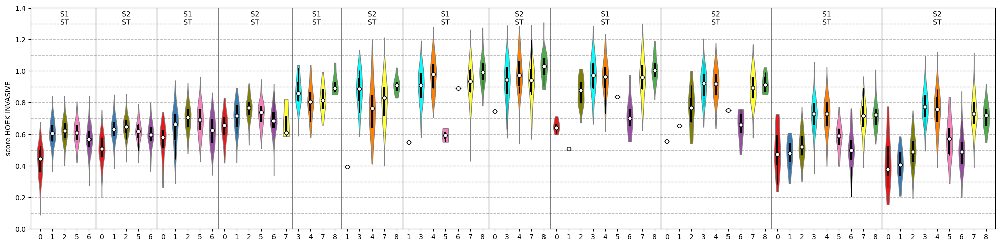

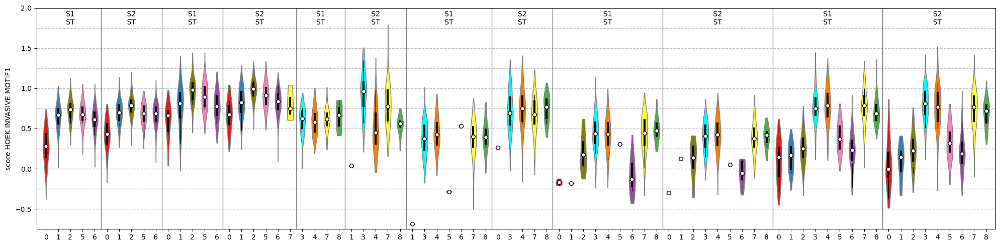

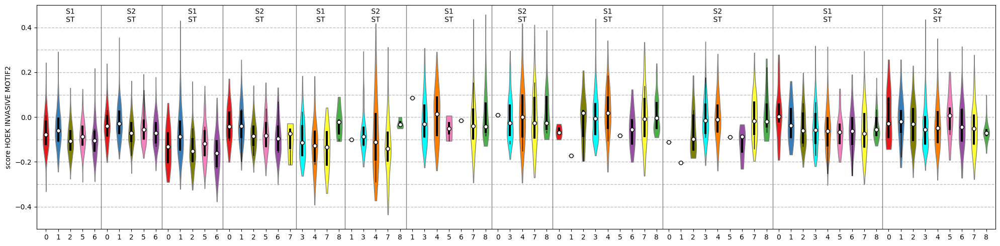

In [23]:
genesDicts.update({'HOEK_INVASIVE_MOTIF1': ['DCT', 'GPR143', 'MATP', 'MLANA', 'SILV', 'TRPM1', 'TYR', 'TYRP1', 'EDNRB', 'ERBB3', 'MBP', 'MITF', 'PLP1']})
genesDicts.update({'HOEK_INVASIVE_MOTIF2': ['BGN', 'CDH2', 'COL5A1', 'CTGF', 'FBN1', 'FGF2', 'IL6', 'INHBA', 'LOX', 'SERPINE1', 'TAGLN', 'TGFBI', 'THBS1', 'TNFRSF11B', 'TPM1', 'TPM2']})
wrapVplotScore('HOEK_INVASIVE', genesDicts=genesDicts, identity='cluster', palette=palette_rna, ads=ads, ids=ids)
wrapVplotScore('HOEK_INVASIVE_MOTIF1', genesDicts=genesDicts, identity='cluster', palette=palette_rna, ads=ads, ids=ids)
wrapVplotScore('HOEK_INVASIVE_MOTIF2', genesDicts=genesDicts, identity='cluster', palette=palette_rna, ads=ads, ids=ids)

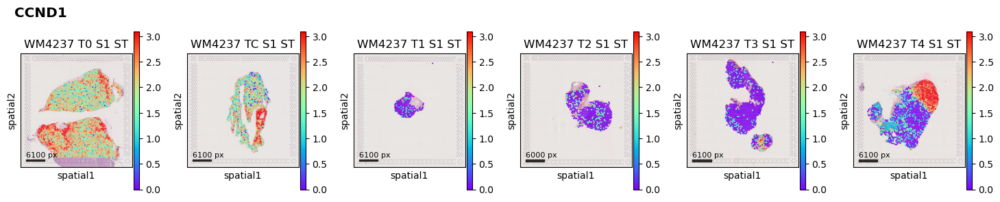

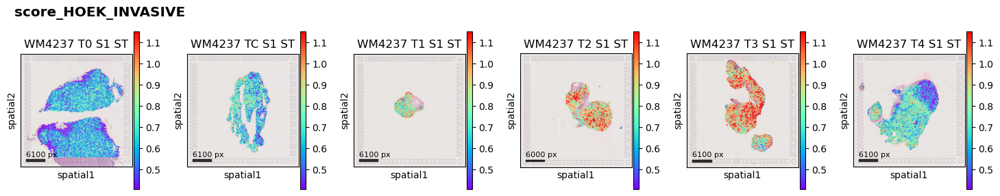

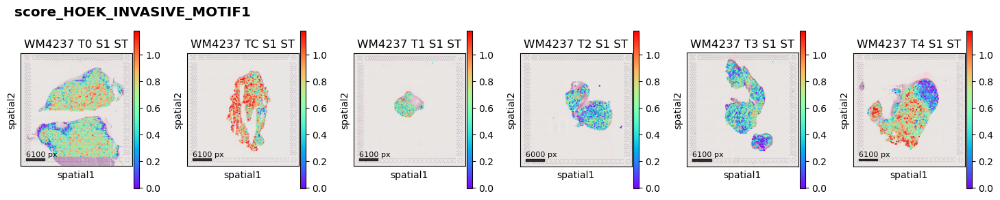

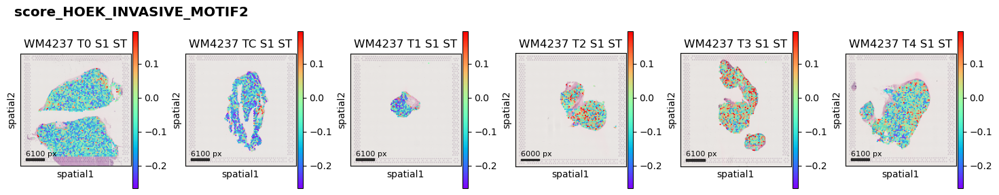

In [26]:
plotSpatialAll(ads, ids=[id for id in ids if ('_S1_' in id)], identity='CCND1', palette=palette_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)
plotSpatialAll(ads, ids=[id for id in ids if ('_S1_' in id)], identity='score_' + 'HOEK_INVASIVE', palette=palette_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)
plotSpatialAll(ads, ids=[id for id in ids if ('_S1_' in id)], identity='score_' + 'HOEK_INVASIVE_MOTIF1', palette=palette_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)
plotSpatialAll(ads, ids=[id for id in ids if ('_S1_' in id)], identity='score_' + 'HOEK_INVASIVE_MOTIF2', palette=palette_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)

In [6]:
ads = {id: ad_all[ad_all.obs['sample']==id, :] for id in ids}

images = {id: sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id).uns['spatial'] for id in ids}

for sample in ids[:]:
    ads[sample] = ad_all[ad_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample]

In [10]:
sg = ["IMMT", "EIF2AK4", "IMMT", "RHOT1", "RHOT2", "DNM1L", "FUNDC1", "HSP90AA1"]

In [11]:
from matplotlib import pyplot as plt

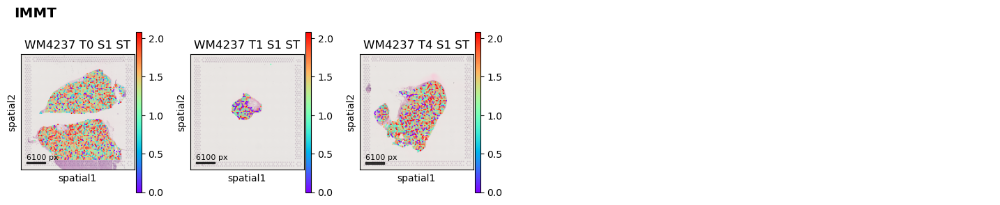

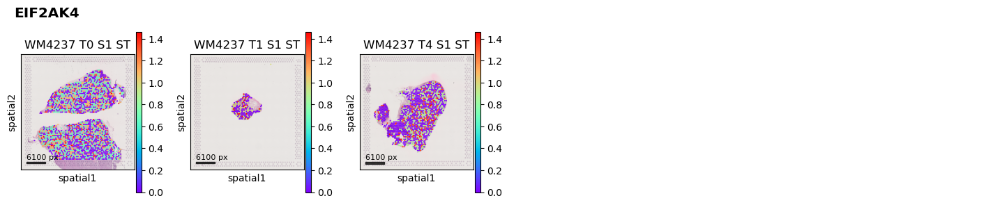

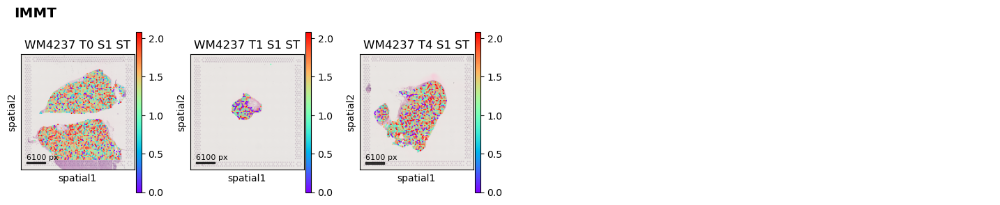

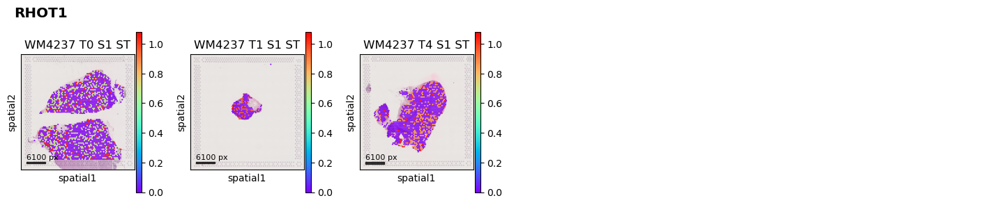

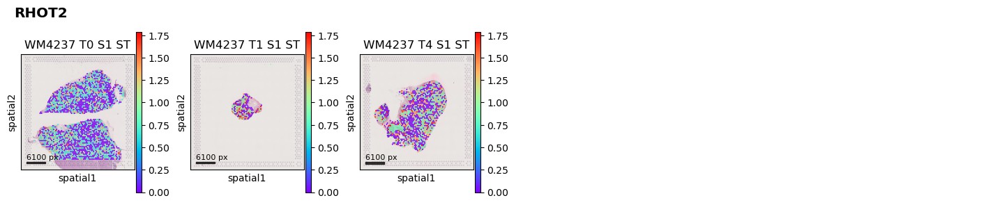

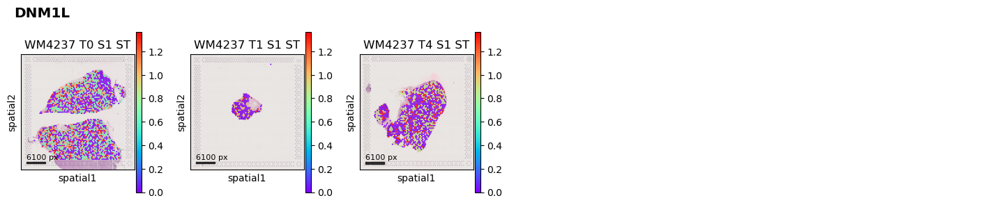

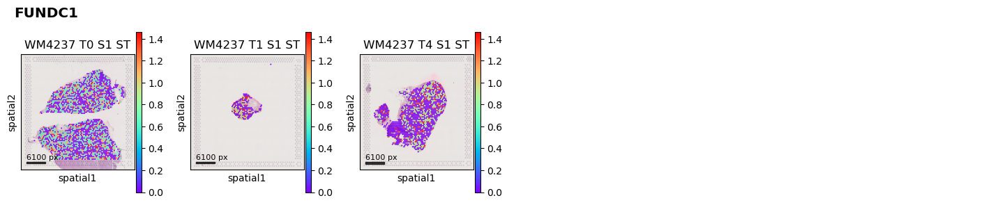

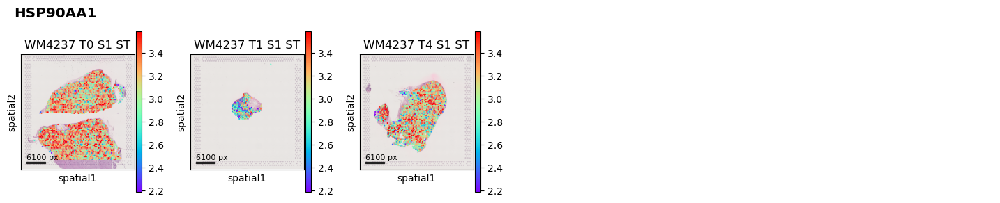

In [12]:
for gene in sg[:]:
    plotSpatialAll(ads, ids=[id for id in ids if (('_S1_' in id) and ('_T0_' in id)) or (('_S1_' in id) and ('_T1_' in id)) or (('_S1_' in id) and ('_T4_' in id))], identity=gene, palette=palette_WM4007_rna, f=0.75, nx=6, panelSize=4, y=1.0, wspace=0.35)
    plt.show()

In [7]:
from matplotlib import cm

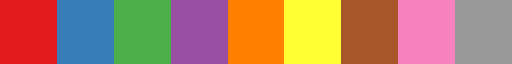

In [8]:
cm.Set1

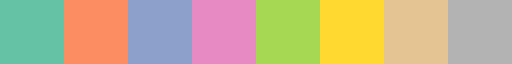

In [9]:
cm.Set2

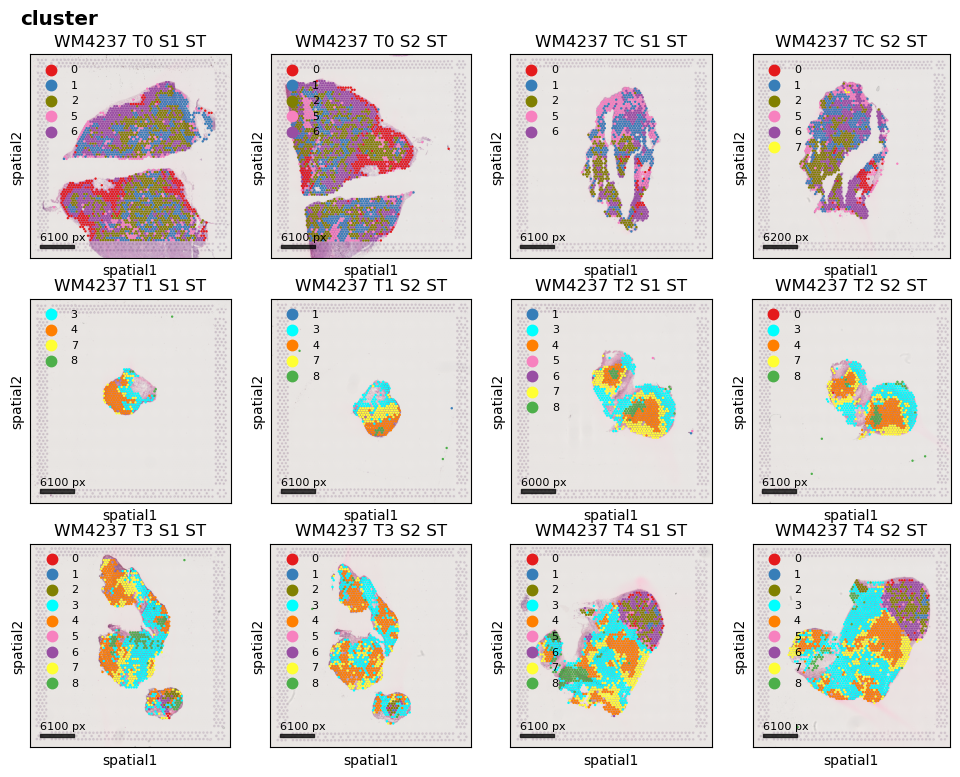

In [10]:
plotSpatialAll(ads, ids=[id for id in ids if '' in id], identity='cluster', palette=palette_WM4237_rna, f=0.75, nx=4, panelSize=4)

In [14]:
ad_all.var.index[ad_all.var.index.str.startswith('MT-')]

Index(['MT-ATP6', 'MT-ATP8', 'MT-CO1', 'MT-CO2', 'MT-CO3', 'MT-CYB', 'MT-ND1',
       'MT-ND2', 'MT-ND3', 'MT-ND4', 'MT-ND4L', 'MT-ND5', 'MT-ND6'],
      dtype='object')

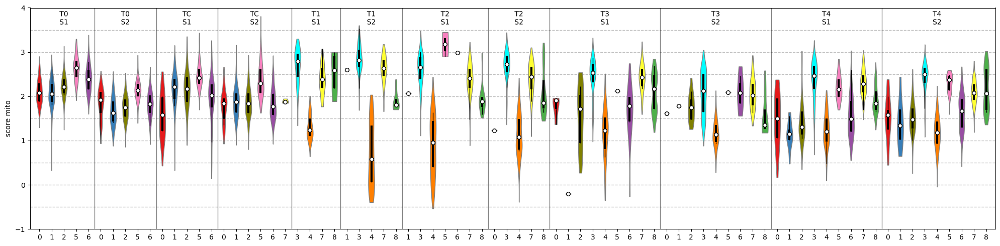

In [18]:
genesDicts.update({'mito': ad_all.var.index[ad_all.var.index.str.startswith('MT-')].values.tolist()})
wrapVplotScore('mito', genesDicts=genesDicts, identity='cluster', palette=palette_rna, ads=ads, ids=ids)

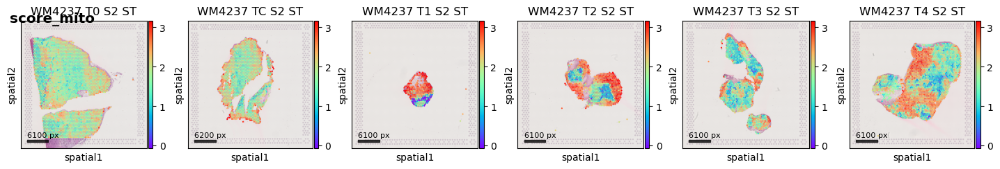

In [21]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='score_mito', palette=palette_rna, f=0.75, fy=0.8, nx=6, panelSize=4)

# Gene expression violin plots

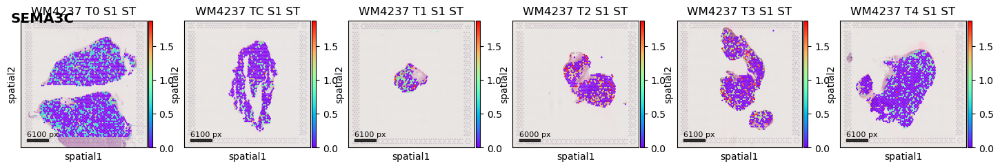

In [7]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='SEMA3C', palette=palette1, f=0.75, fy=0.8, nx=6, panelSize=4)

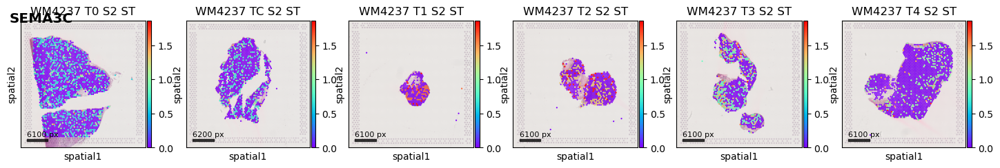

In [8]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='SEMA3C', palette=palette1, f=0.75, fy=0.8, nx=6, panelSize=4)

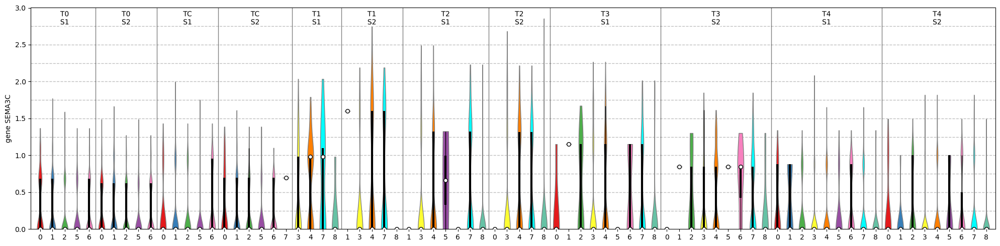

In [9]:
for gene in ['SEMA3C']:
    wrapVplotGene(gene, 'cluster', palette=palette1, ads=ads, ids=ids, selected=[])

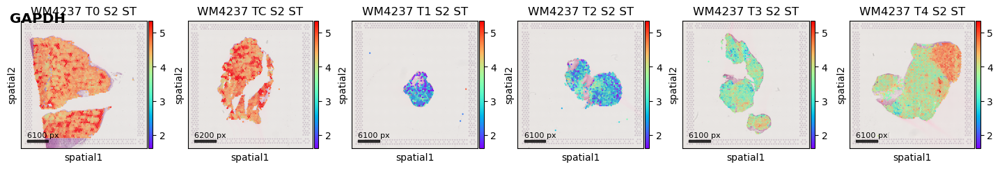

In [22]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='GAPDH', palette=palette1, f=0.75, fy=0.8, nx=6, panelSize=4)

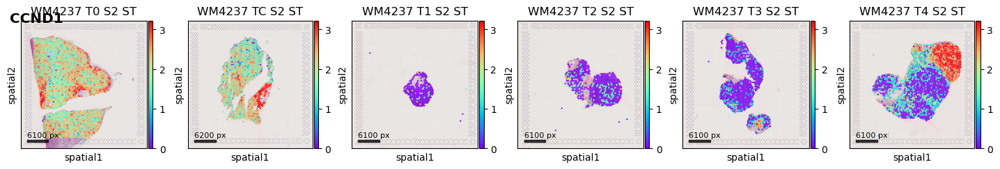

In [23]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='CCND1', palette=palette1, f=0.75, fy=0.8, nx=6, panelSize=4)

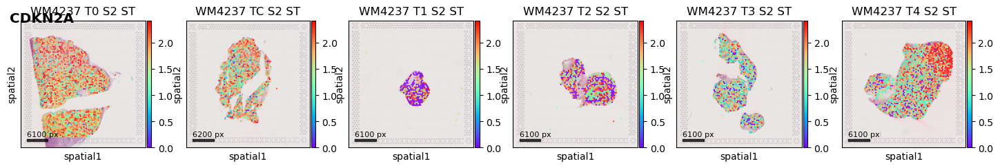

In [25]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='CDKN2A', palette=palette1, f=0.75, fy=0.8, nx=6, panelSize=4)

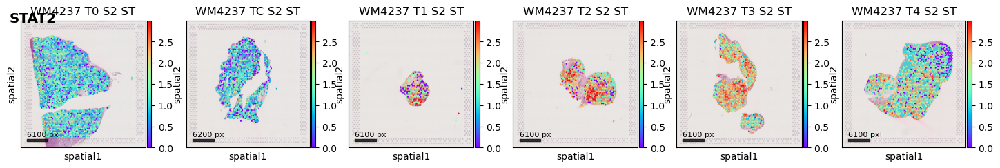

In [26]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='STAT2', palette=palette1, f=0.75, fy=0.8, nx=6, panelSize=4)

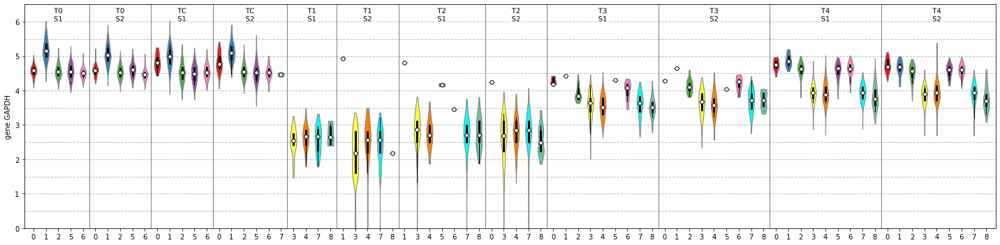

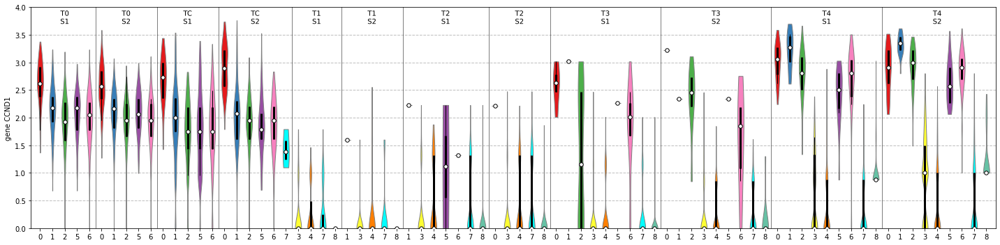

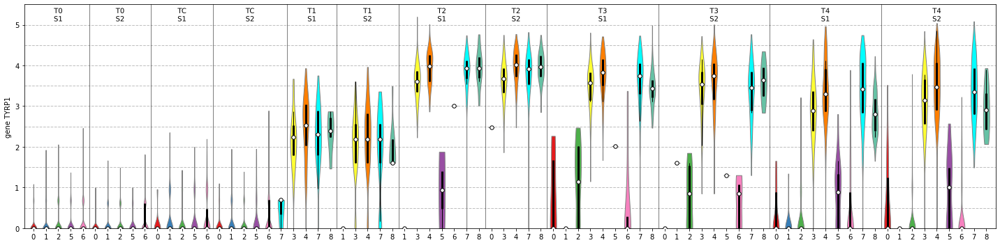

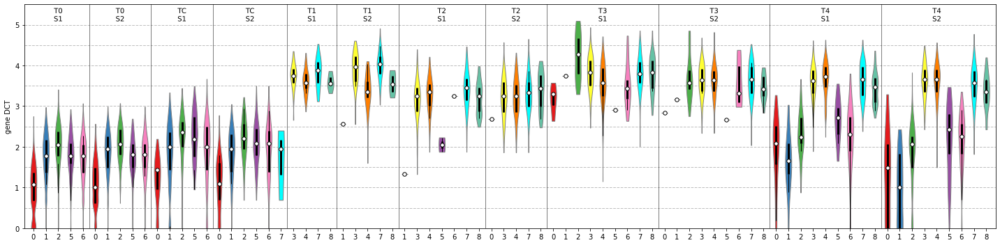

In [45]:
for gene in ['GAPDH','CCND1','TYRP1','DCT']:
    wrapVplotGene(gene, 'cluster', palette=palette1, ads=ads, ids=ids, selected=[])

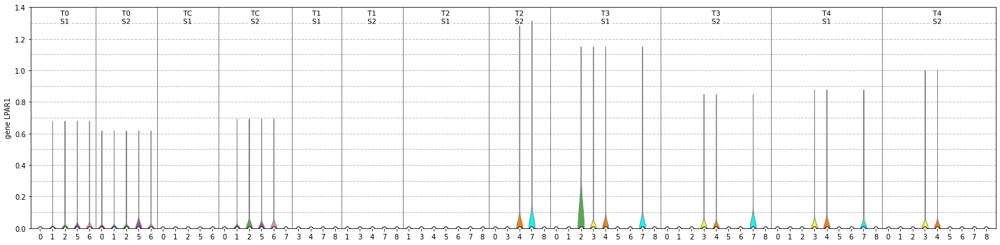

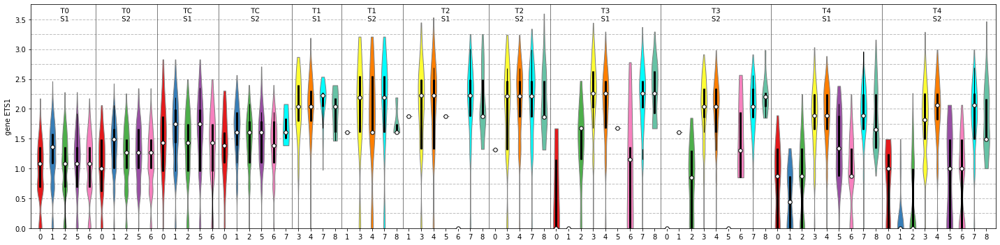

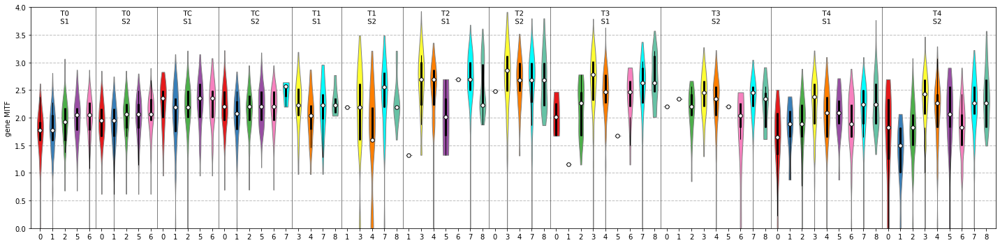

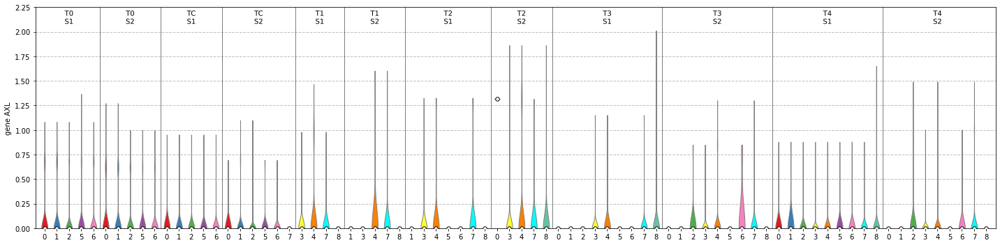

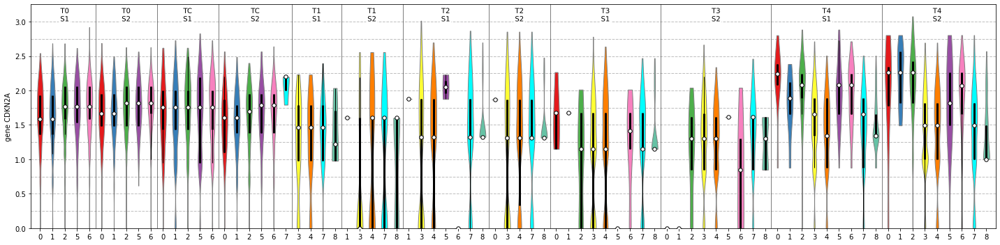

...

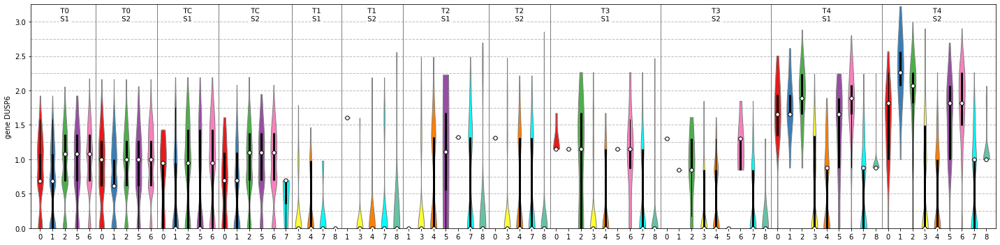

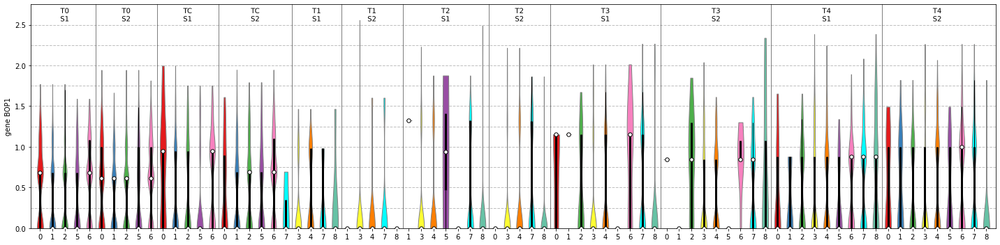

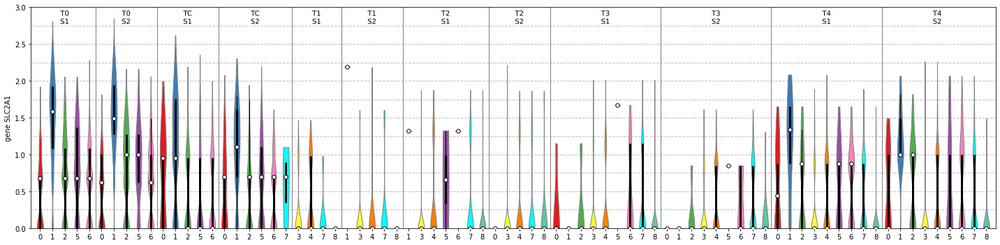

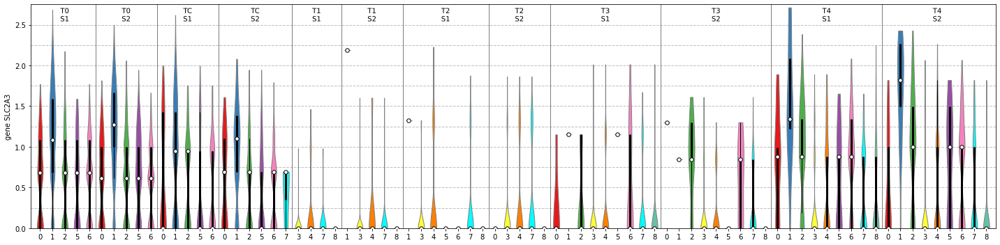

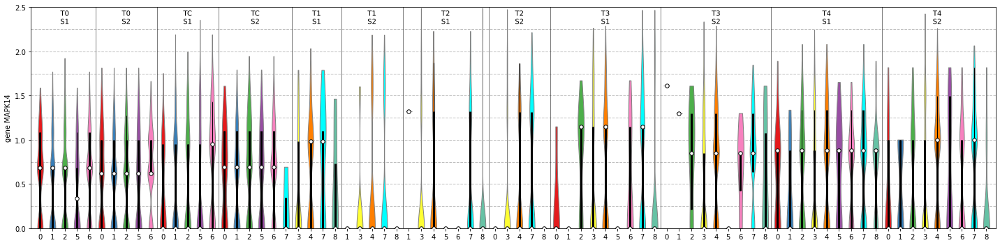

In [ ]:
for gene in ['LPAR1', 'ETS1','MITF','AXL','CDKN2A','CCND1','STAT2','MAPK1','MAPK3','DUSP4','DUSP6','BOP1','SLC2A1','SLC2A3','MAPK14',
             'MAPK11','ATF4','RAB32','FANCD2','MCM2','GAPDH','CCND1','TYRP1','DCT','MITF','NGFR','KDM5B']:
    wrapVplotGene(gene, 'cluster', palette=palette1, ads=ads, ids=ids, selected=[])

# Pathway score violin plots

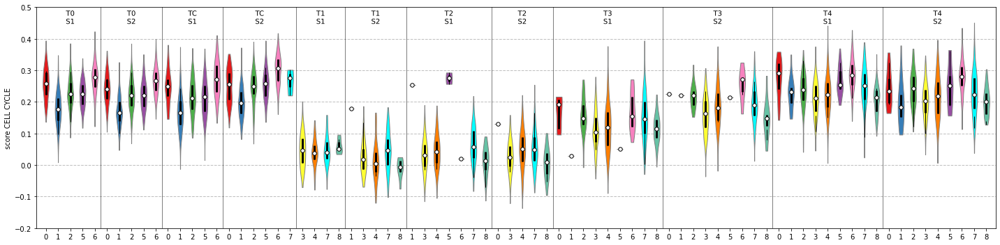

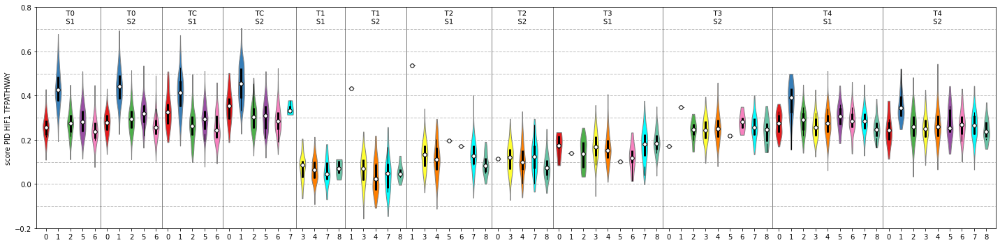

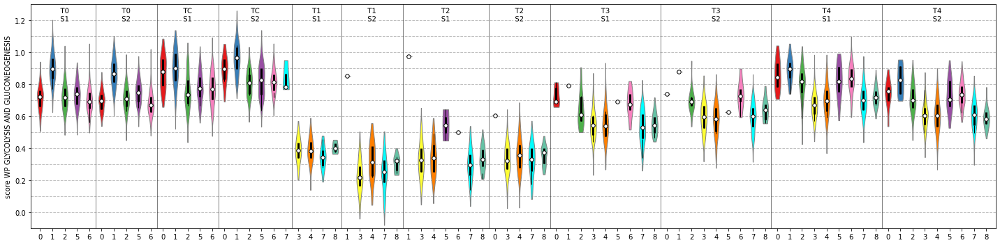

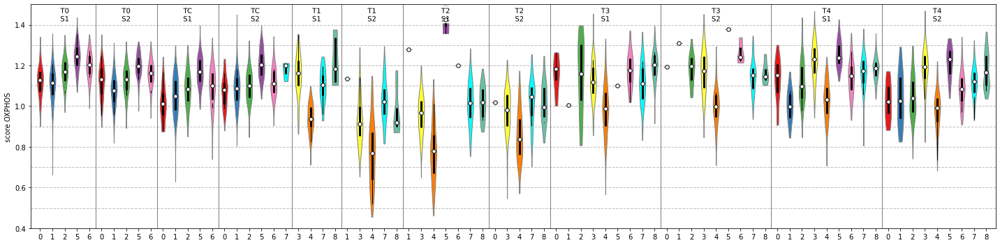

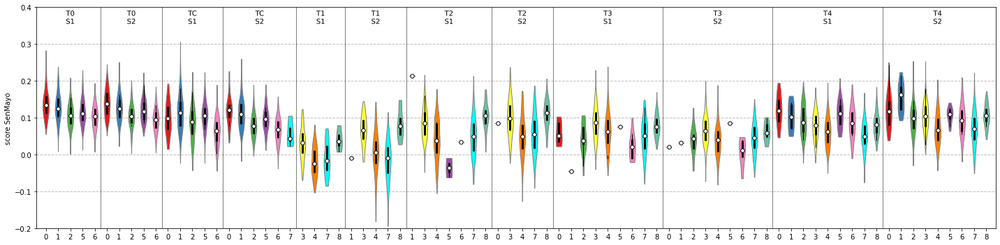

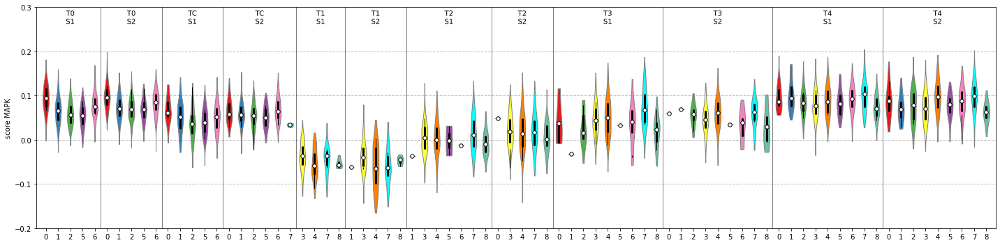

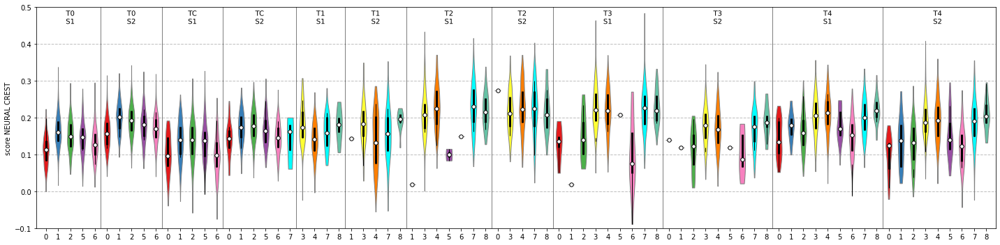

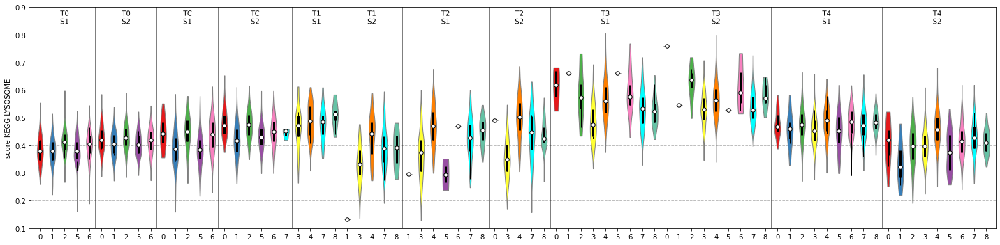

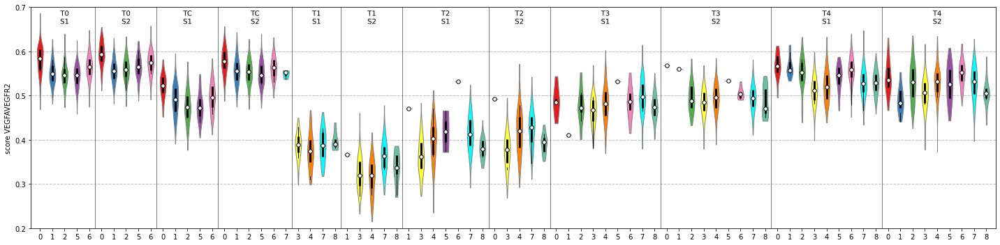

In [12]:
for geneset in ['CELL_CYCLE', 'PID_HIF1_TFPATHWAY', 'WP_GLYCOLYSIS_AND_GLUCONEOGENESIS', 'OXPHOS', 'SenMayo', 'MAPK', 'NEURAL_CREST', 'KEGG_LYSOSOME', 'VEGFAVEGFR2']:
    wrapVplotScore(geneset, genesDicts=genesDicts, identity='cluster', palette=palette1, ads=ads, ids=ids)

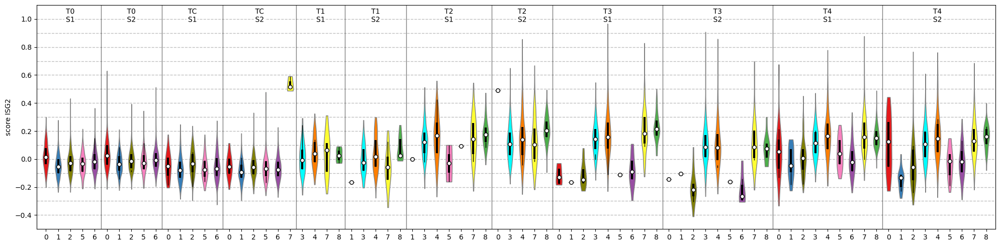

In [11]:
for geneset in ['ISG2']:
# for geneset in ['ISG1', 'ISG2', 'ISG3', 'KEGG_LYSOSOME', 'MAPK']:
    wrapVplotScore(geneset, genesDicts=genesDicts, identity='cluster', palette=palette_rna, ads=ads, ids=ids)

# Pathway score ratio violin plots

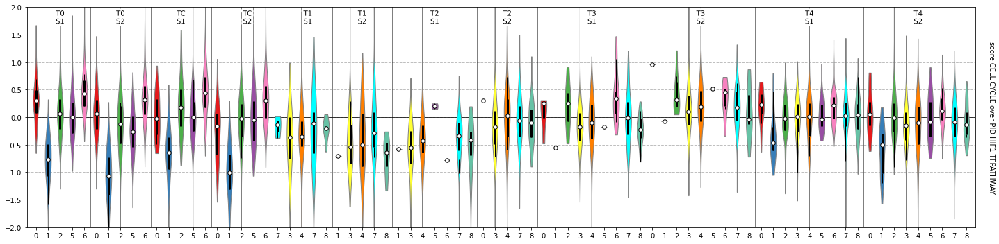

In [7]:
wrapVplotRatio('CELL_CYCLE', 'PID_HIF1_TFPATHWAY', genesDicts=genesDicts, ads=ads, ids=ids, identity='cluster', palette=palette1, vmin=-2, vmax=2)

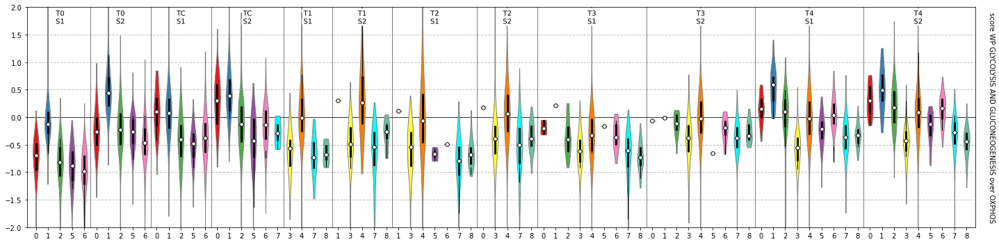

In [8]:
wrapVplotRatio('WP_GLYCOLYSIS_AND_GLUCONEOGENESIS', 'OXPHOS', genesDicts=genesDicts, ads=ads, ids=ids, identity='cluster', palette=palette1, vmin=-2, vmax=2)

# Spatial layout

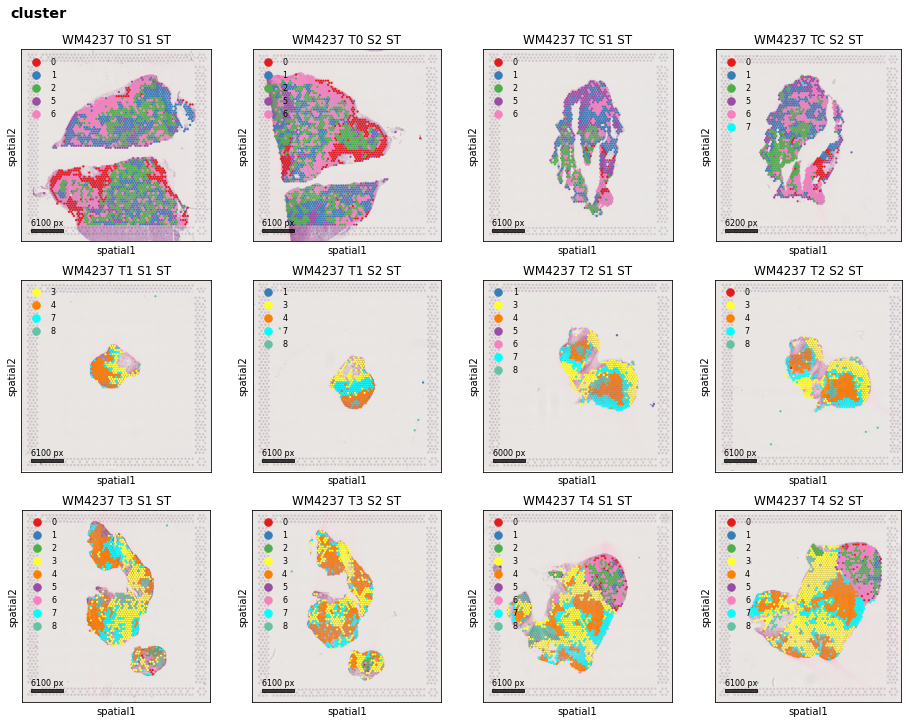

In [47]:
plotSpatialAll(ads, ids=[id for id in ids if '' in id], identity='cluster', palette=palette1, f=1.0, nx=4, panelSize=4)

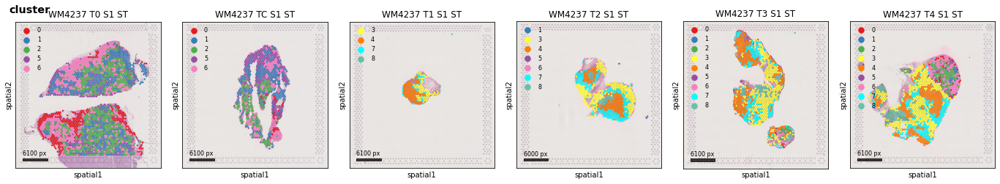

In [9]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='cluster', palette=palette1, f=1.0, nx=6, panelSize=4)

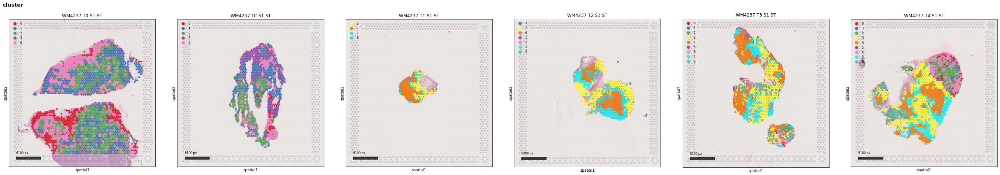

In [43]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='cluster', palette=palette1, f=2.0, nx=6, panelSize=4)

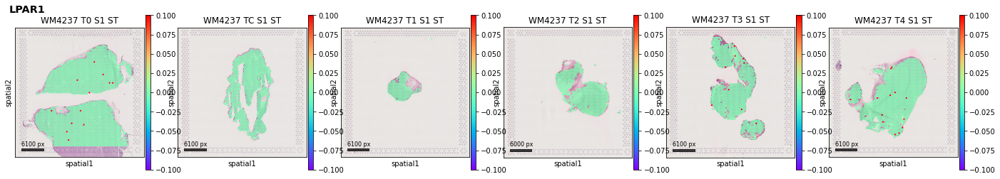

In [10]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='LPAR1', palette=palette1, f=1.0, nx=6, panelSize=4)

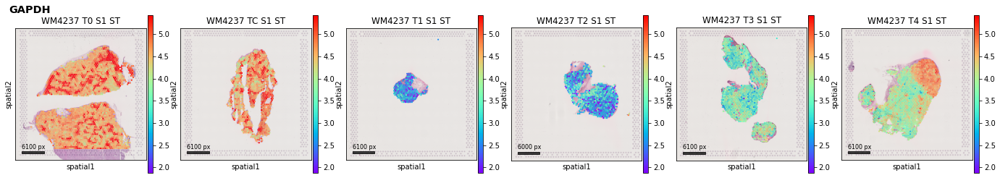

In [44]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='GAPDH', palette=palette1, f=1.0, nx=6, panelSize=4)

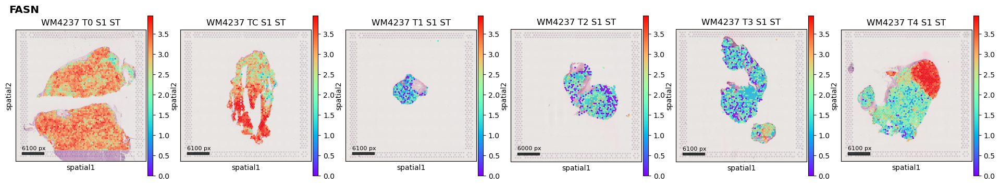

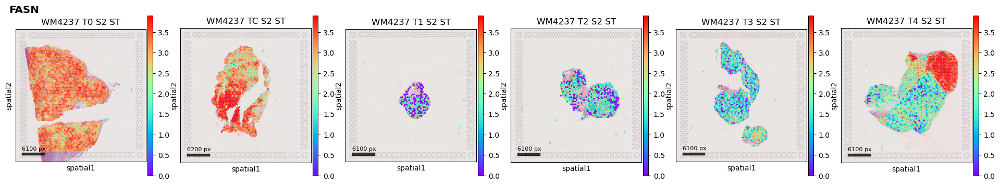

In [8]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='FASN', palette=palette_rna, f=1.0, nx=6, panelSize=4)
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='FASN', palette=palette_rna, f=1.0, nx=6, panelSize=4)

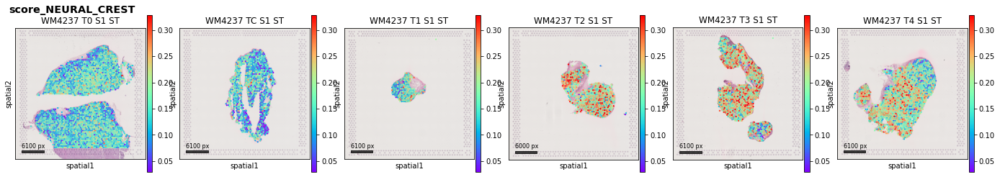

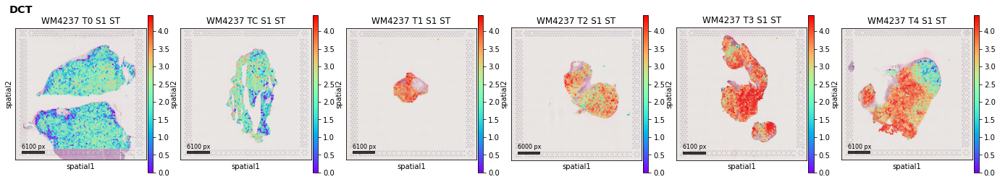

In [14]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='score_NEURAL_CREST', palette=palette1, f=1.0, nx=6, panelSize=4)
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='DCT', palette=palette1, f=1.0, nx=6, panelSize=4)

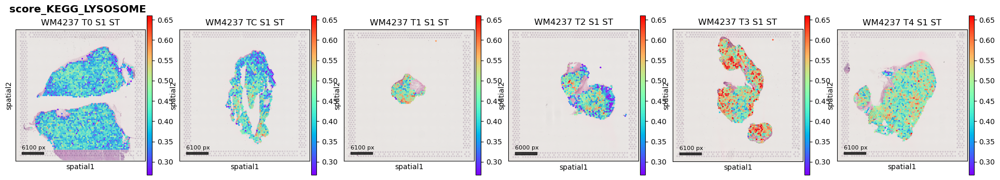

In [13]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='score_KEGG_LYSOSOME', palette=palette1, f=1.0, nx=6, panelSize=4)

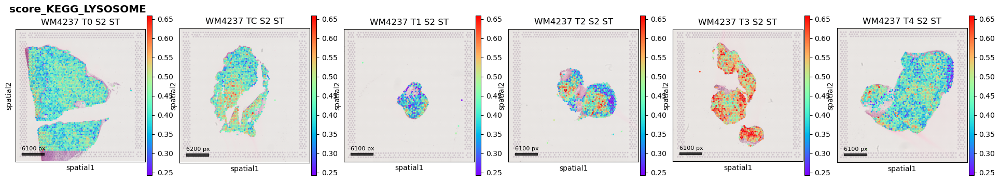

In [15]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='score_KEGG_LYSOSOME', palette=palette1, f=1.0, nx=6, panelSize=4)

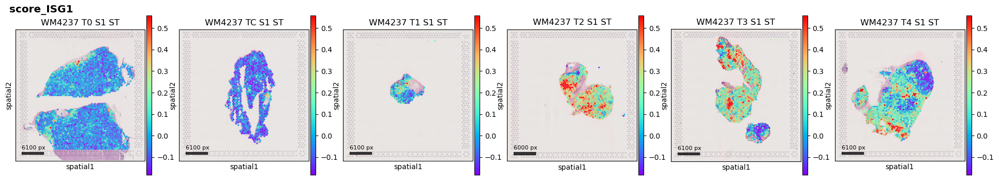

In [9]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='score_ISG1', palette=palette1, f=1.0, nx=6, panelSize=4)

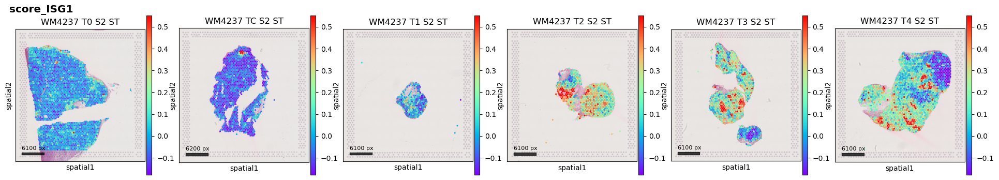

In [14]:
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='score_ISG1', palette=palette1, f=1.0, nx=6, panelSize=4)

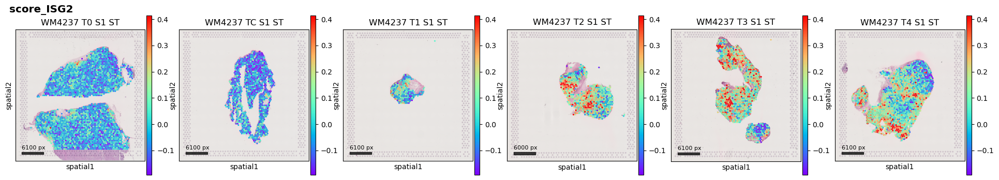

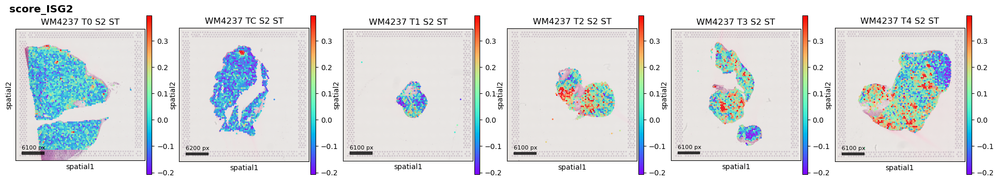

In [12]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='score_ISG2', palette=palette_rna, f=1.0, nx=6, panelSize=4)
plotSpatialAll(ads, ids=[id for id in ids if '_S2_' in id], identity='score_ISG2', palette=palette_rna, f=1.0, nx=6, panelSize=4)

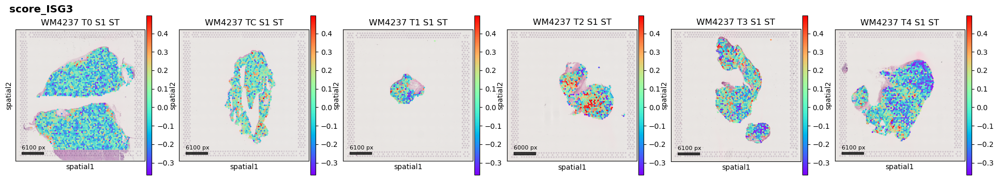

In [11]:
plotSpatialAll(ads, ids=[id for id in ids if '_S1_' in id], identity='score_ISG3', palette=palette1, f=1.0, nx=6, panelSize=4)

# Heatmap plots

In [16]:
df_all, df_meta = prepForCplot(ad_all, sample_name='sample', cluster_name='cluster', quantile=0.95, cap=1.)

(18720, 18406)


After filtering: (210, 18387)


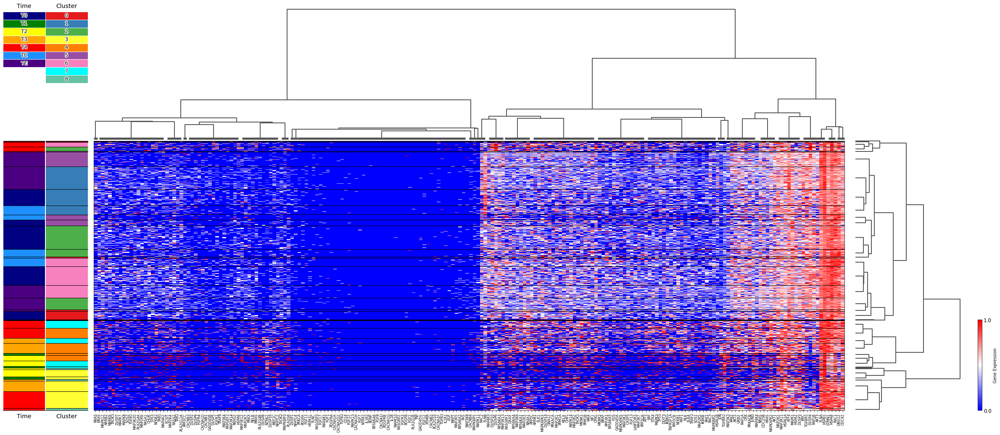

In [17]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['MAPK'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=8, addLinesOnHeatmap=True, figsize=(40,15));

After filtering: (118, 18387)


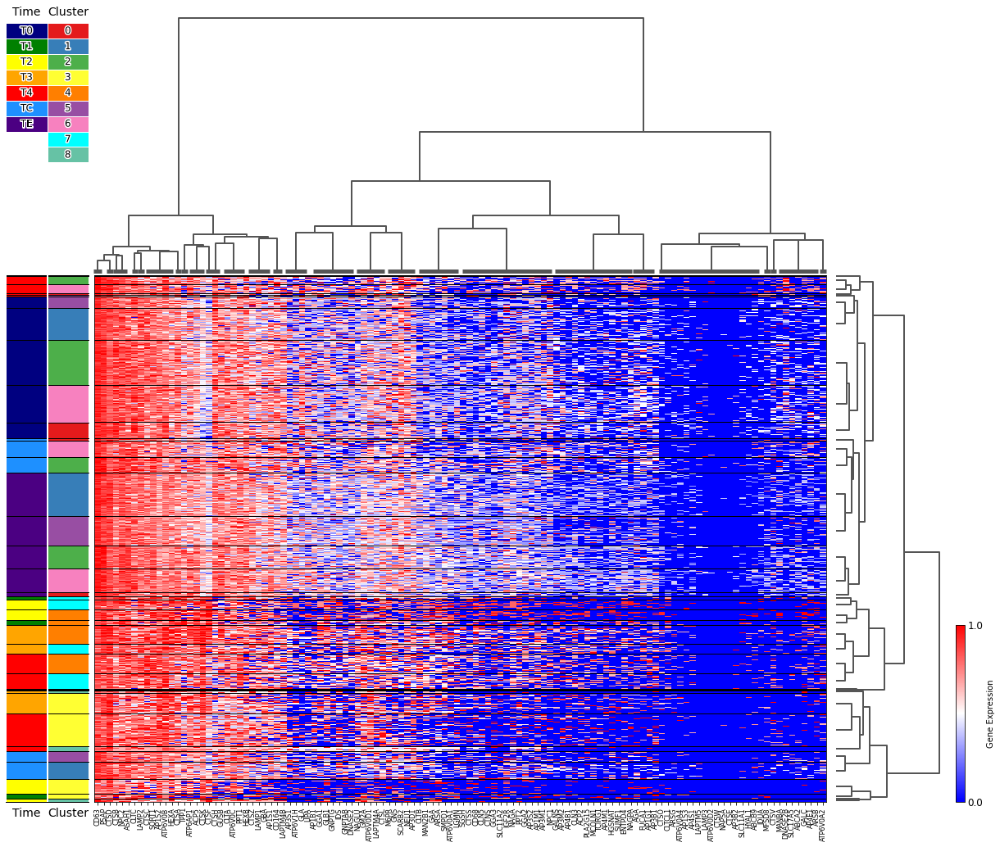

In [18]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['KEGG_LYSOSOME'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=8, addLinesOnHeatmap=True);

After filtering: (79, 18387)


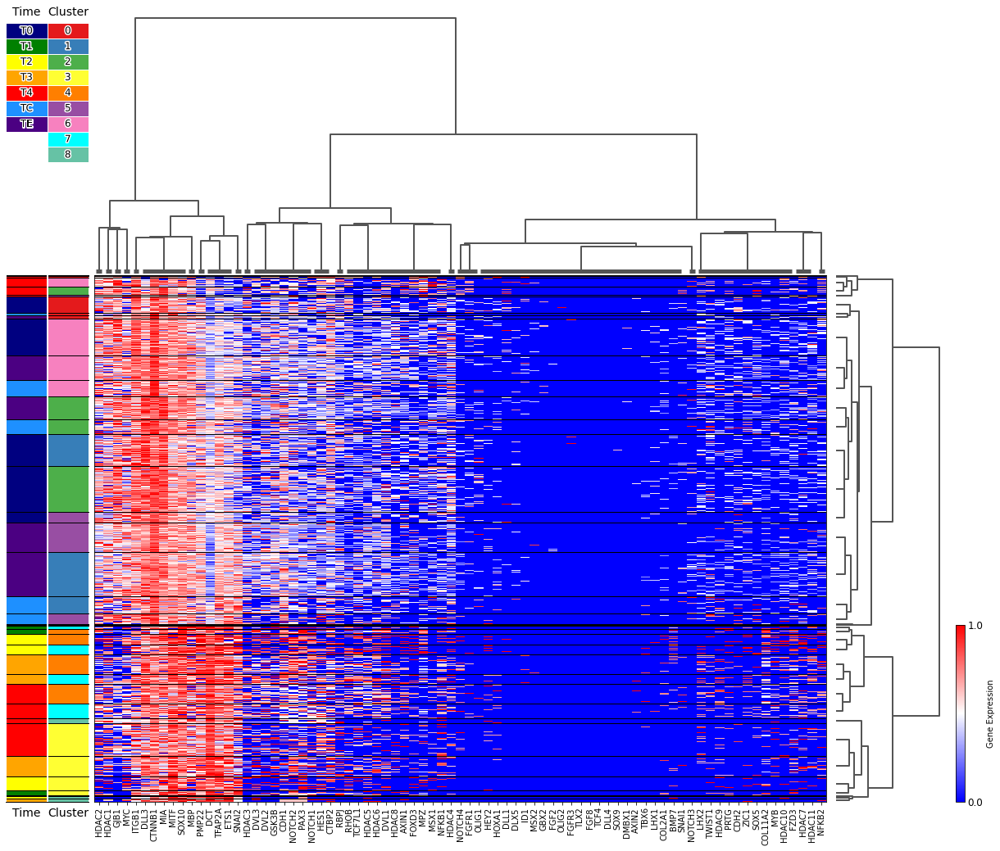

In [19]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['NEURAL_CREST'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True);

After filtering: (100, 18387)


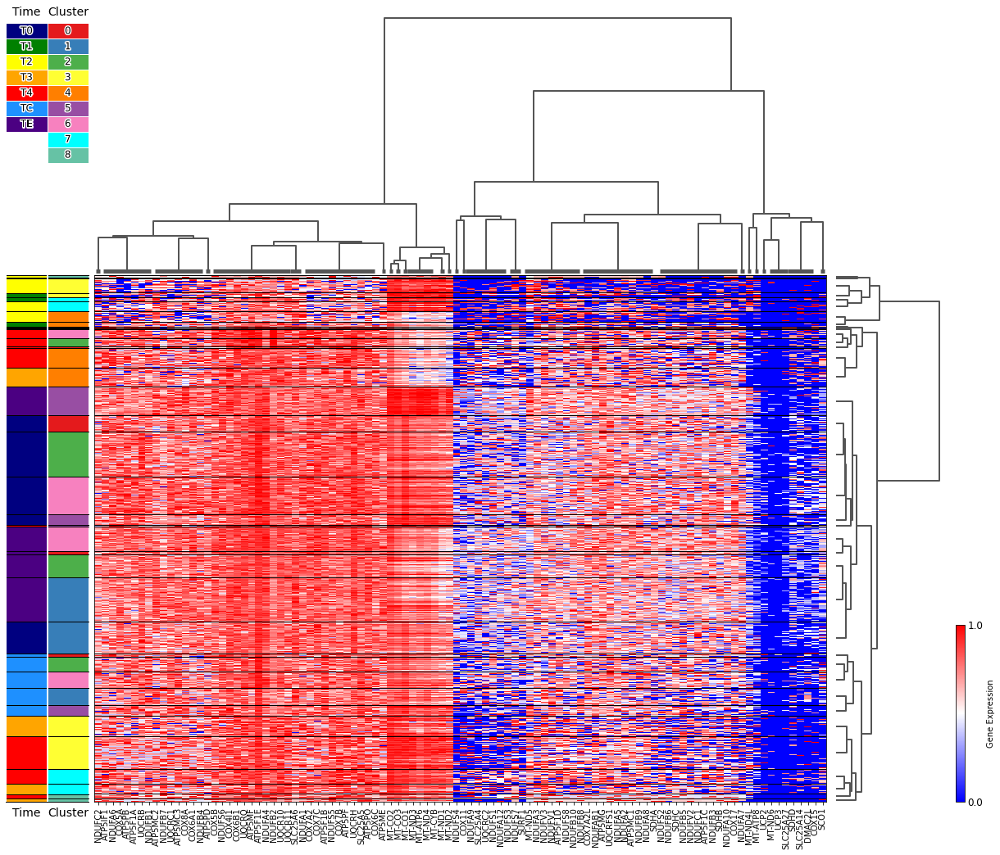

In [20]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['OXPHOS'])], df_meta[['time', 'cluster']] # .sort_values(by=['cluster', 'time'], ascending=False)
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True);

After filtering: (61, 18387)


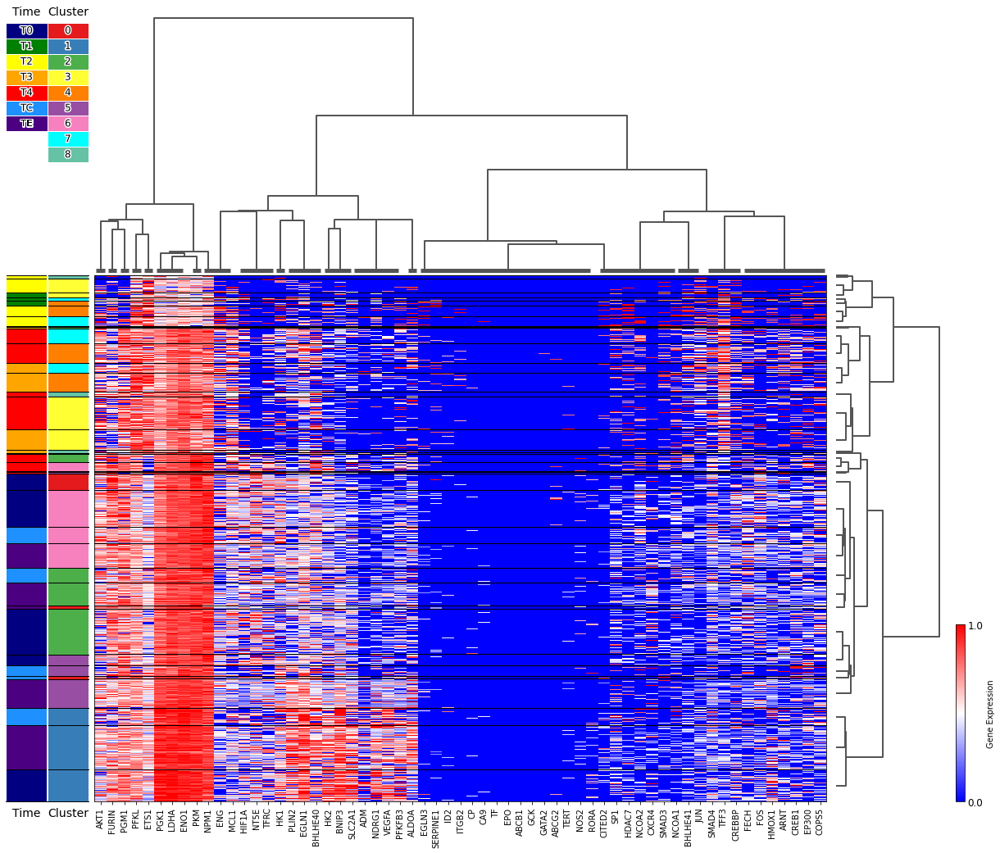

In [21]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['PID_HIF1_TFPATHWAY'])], df_meta[['time', 'cluster']] # .sort_values(by=['cluster', 'time'], ascending=False)
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True);

After filtering: (121, 18387)


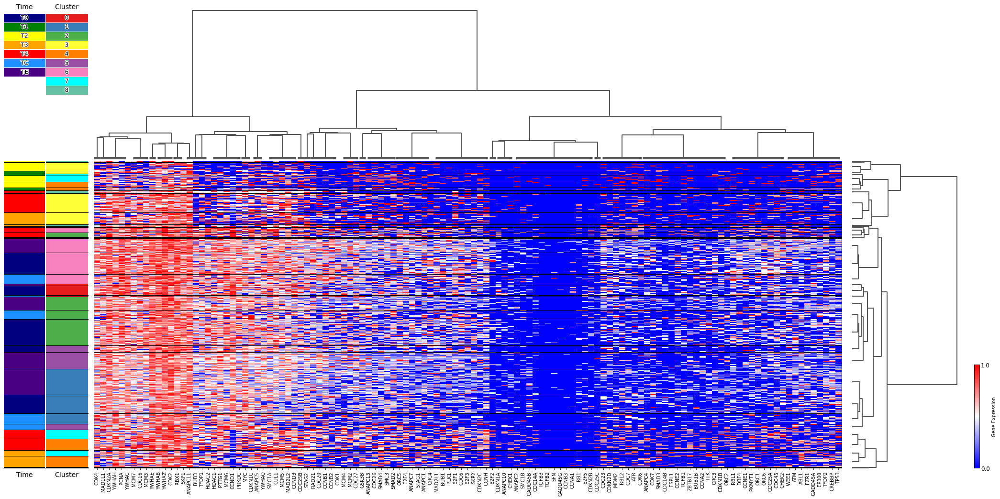

In [22]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['CELL_CYCLE'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(35,15));

After filtering: (56, 18387)


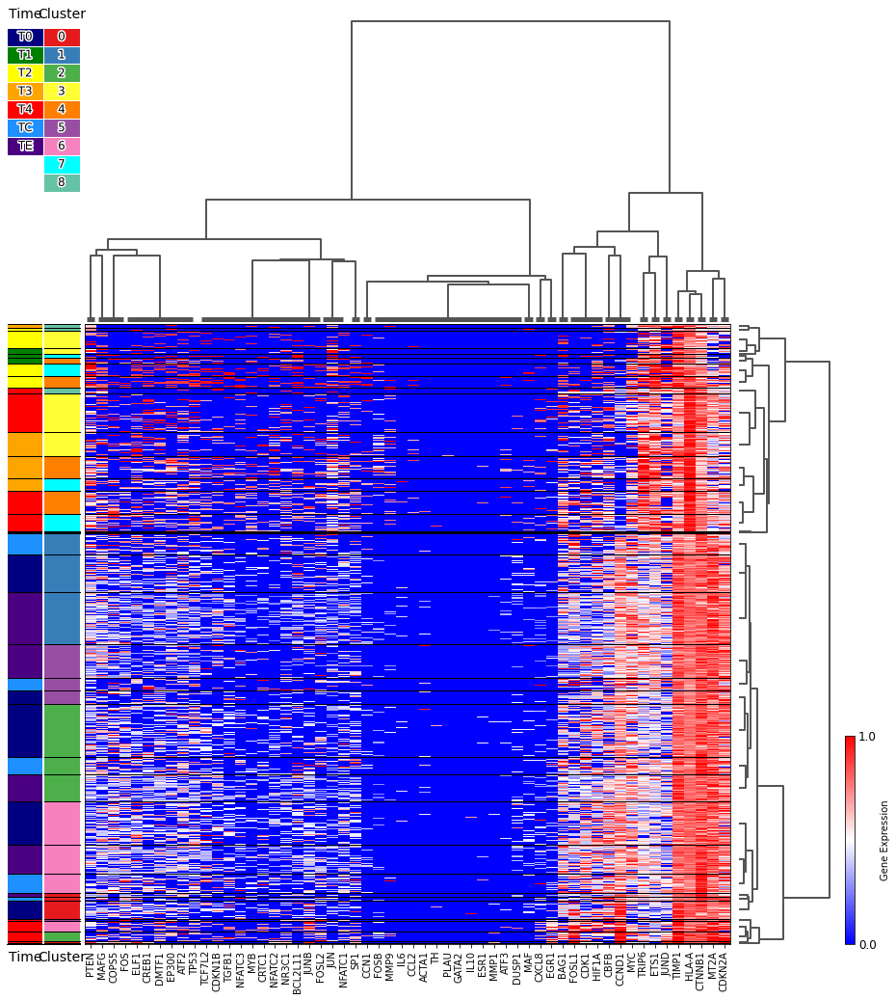

In [23]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['AP1'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(15,15));

After filtering: (57, 18387)


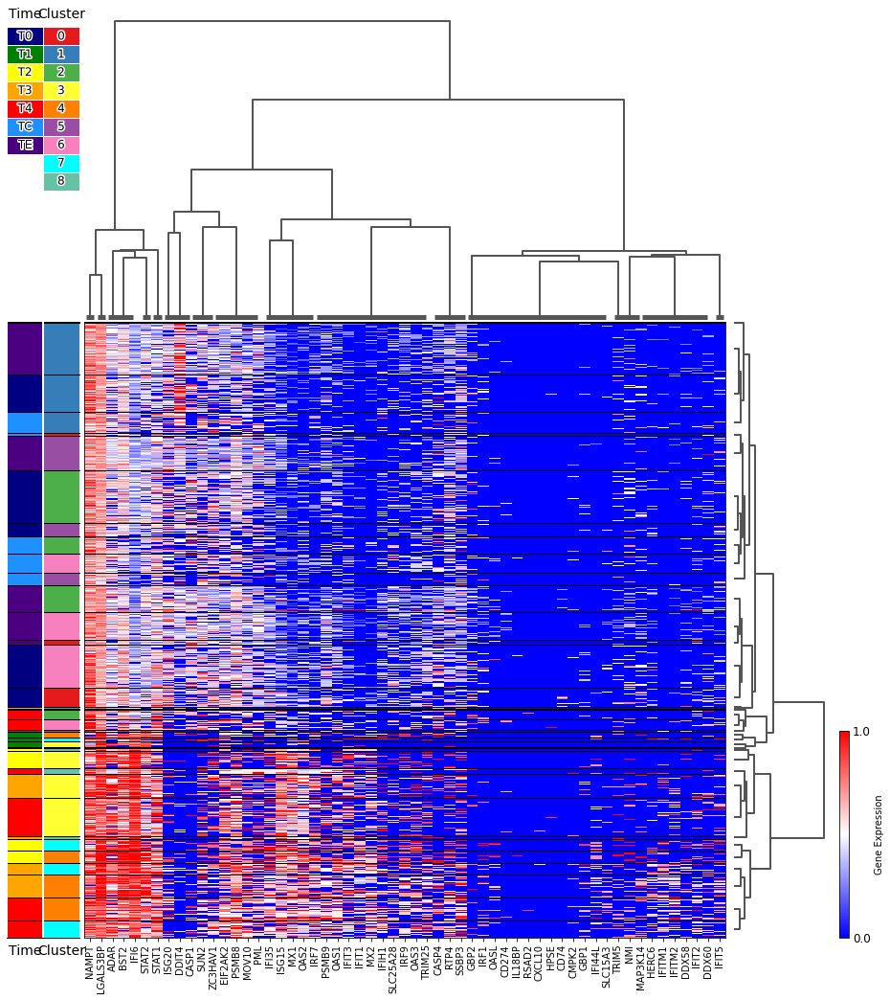

In [24]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(pd.Index(genesDicts['ISG1']).union(genesDicts['ISG2']))], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(15,15));

After filtering: (99, 18387)


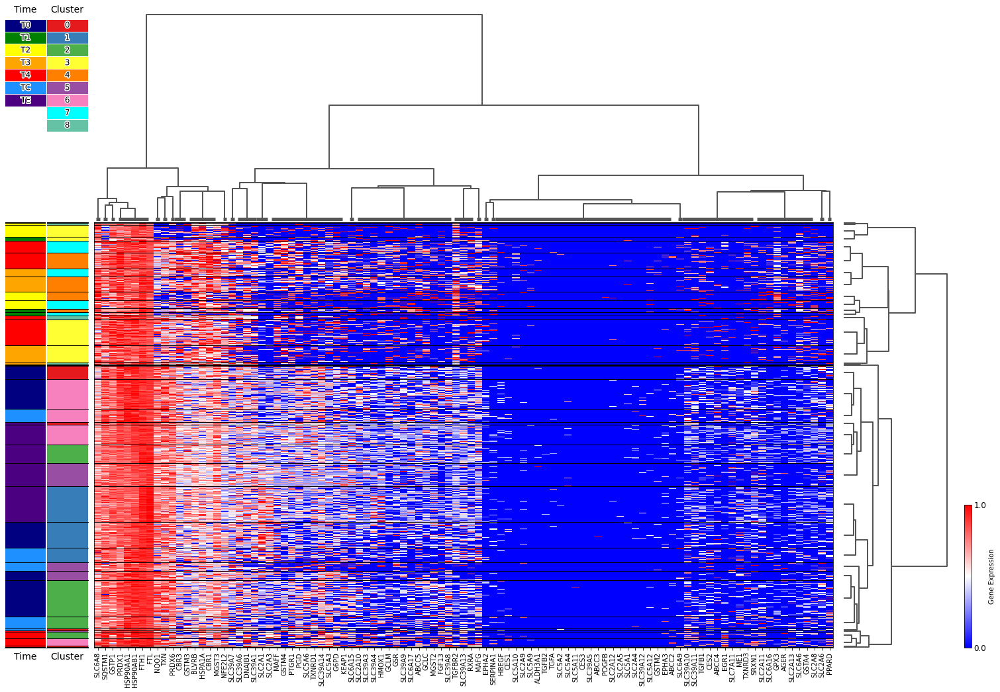

In [25]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['NRF2'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(25,15));

After filtering: (98, 18387)


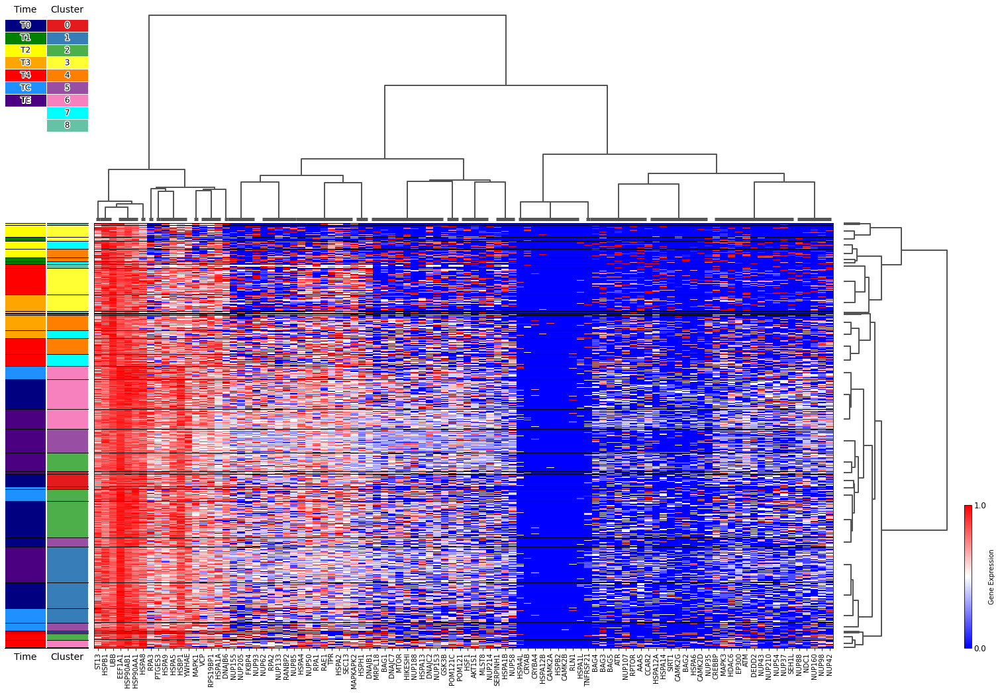

In [26]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['HEAT'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(25,15));

After filtering: (57, 18387)


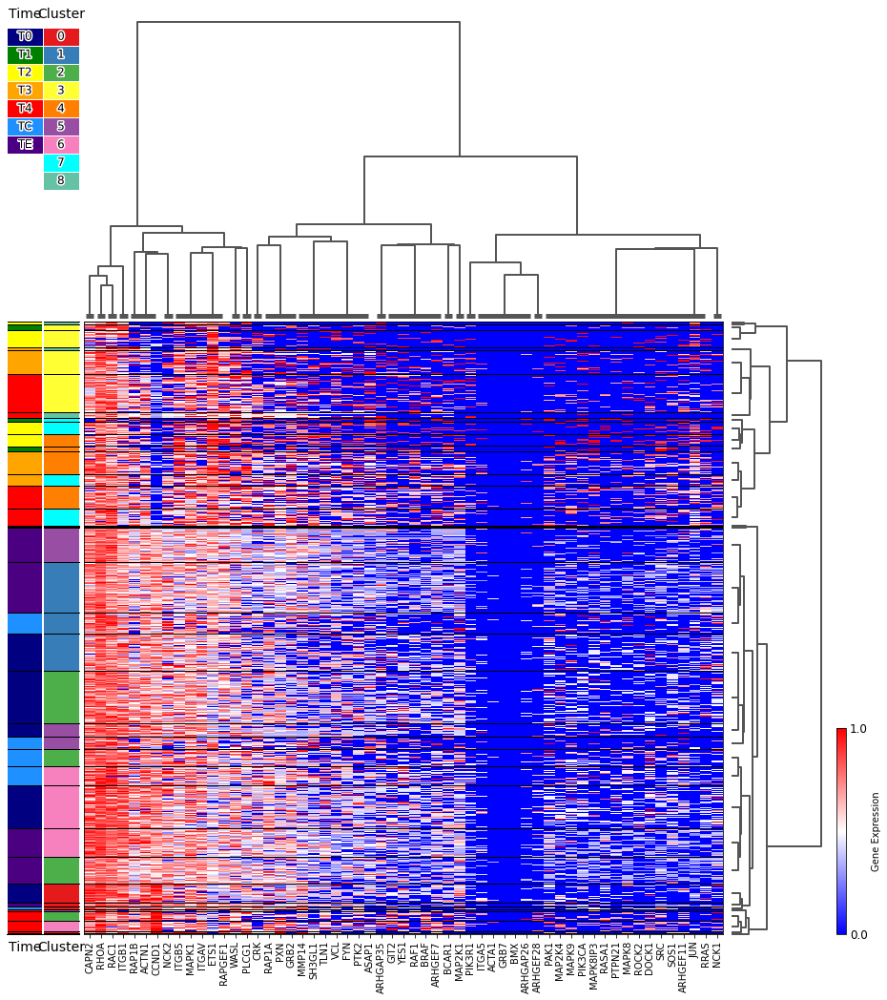

In [27]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['FAK'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(15,15));

After filtering: (101, 18387)


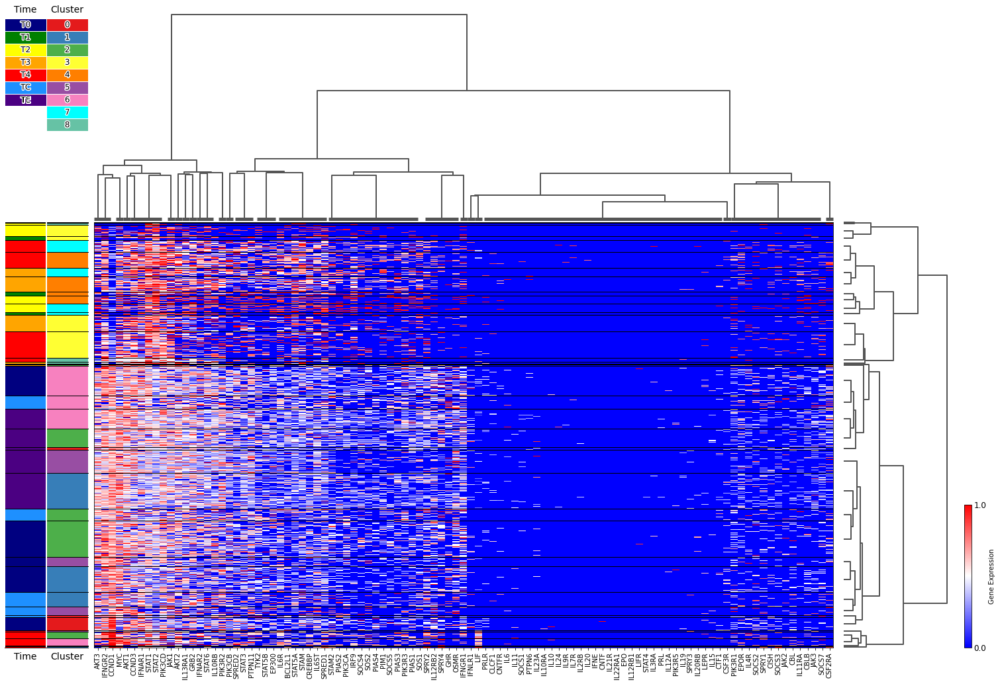

In [28]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['KEGG_JAK_STAT'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(25,15));

After filtering: (395, 18387)


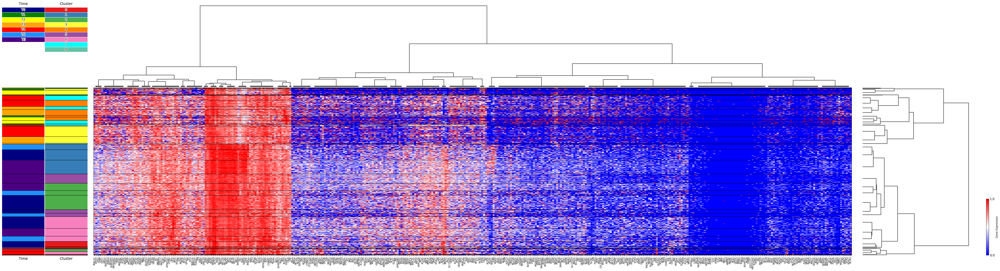

In [29]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['VEGFAVEGFR2'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=8, addLinesOnHeatmap=True, figsize=(65,15));

After filtering: (92, 18387)


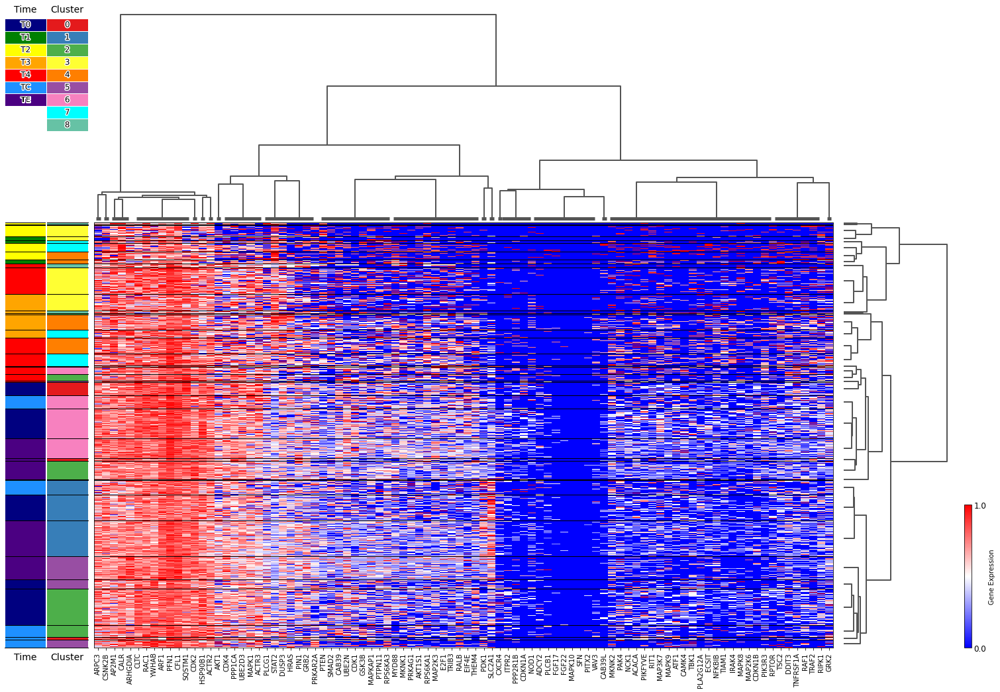

In [30]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['PI3K_AKT_MTOR'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(25,15));

After filtering: (81, 18387)


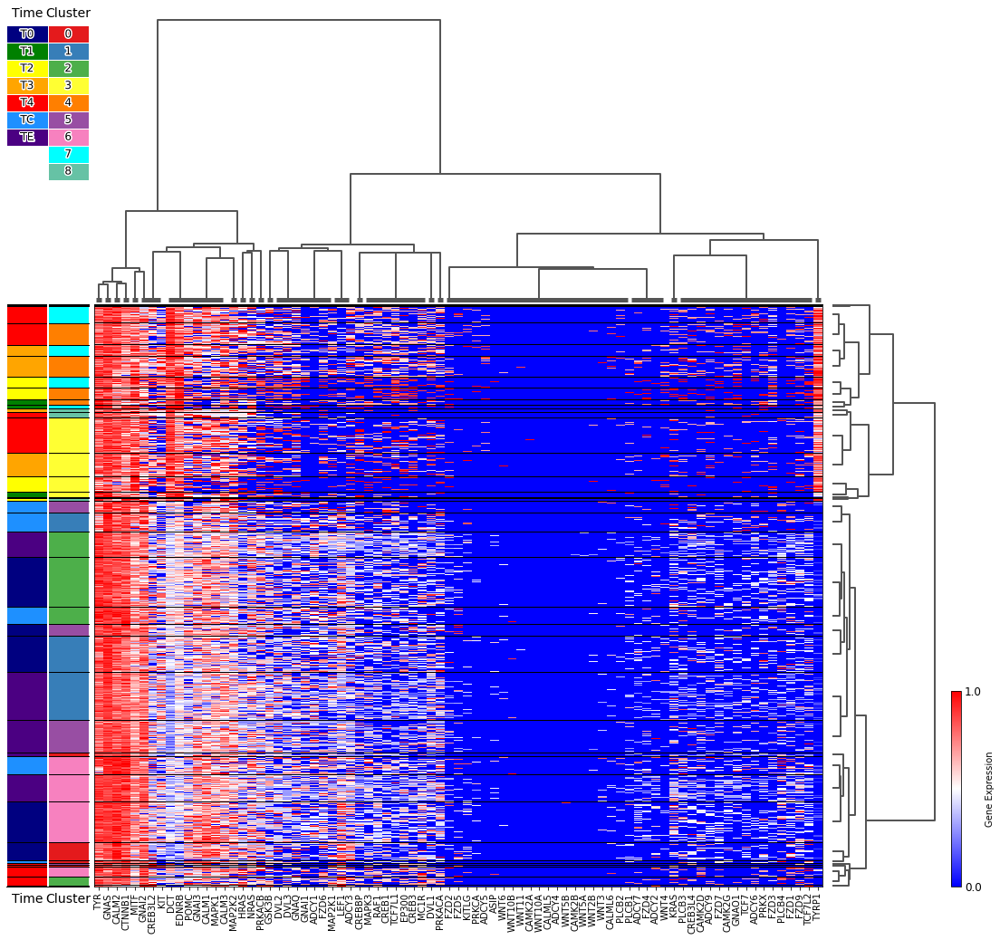

In [31]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['MELANOGENESIS'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(18,15));

After filtering: (54, 18387)


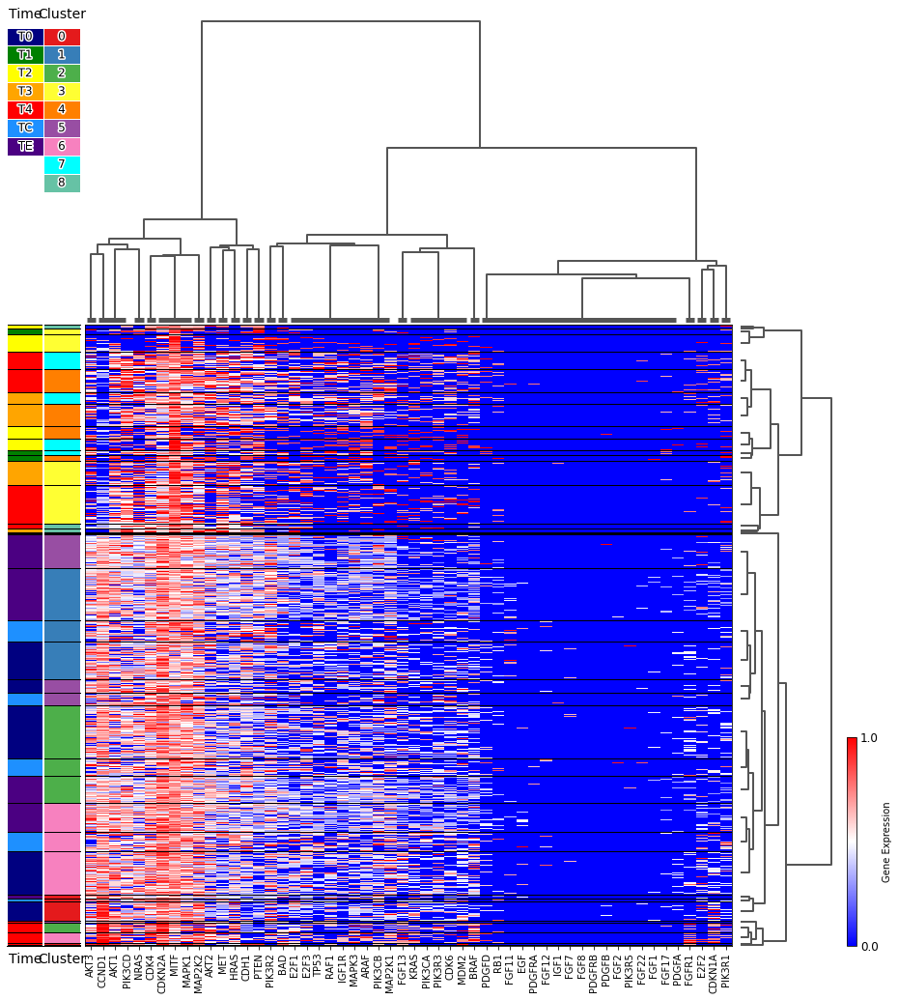

In [32]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['MELANOMA'])], df_meta[['time', 'cluster']]
cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(15,15));

After filtering: (137, 18387)


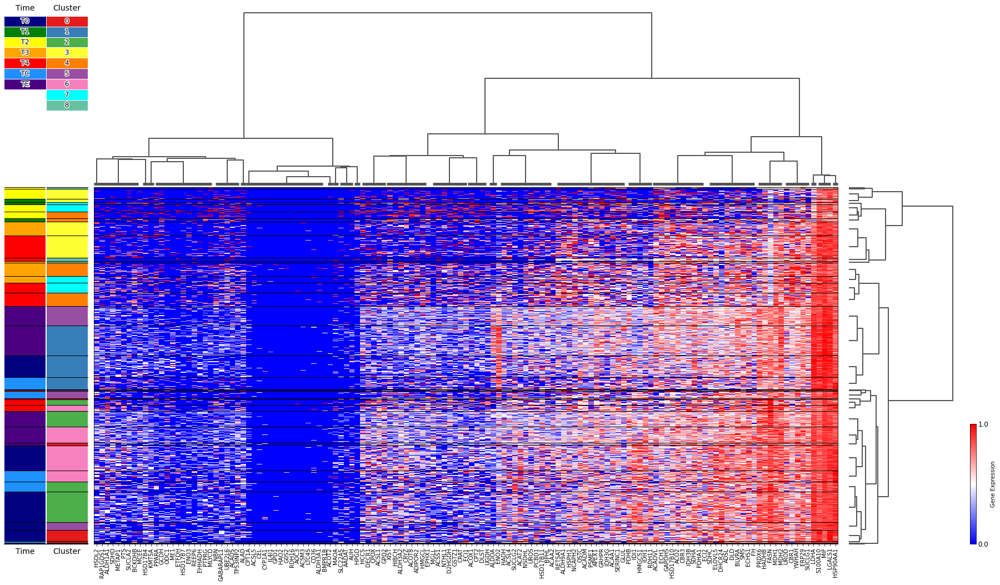

In [39]:
df_temp, df_meta_temp = df_all.loc[df_all.index.intersection(genesDicts['HALLMARK_FATTY_ACID'])], df_meta[['time', 'cluster']]
res = cplot(df_temp[df_meta_temp.index], df_meta_temp, palette=palette1, clusterVar=True, clusterObs=True, addGeneLabels=True, fontsizeGeneLabels=10, addLinesOnHeatmap=True, figsize=(30,15));